<div style="
    background-color: #EEF4FF;
    padding: 36px;
    border-radius: 14px;
    text-align: center;
    font-family: 'Segoe UI', 'Helvetica Neue', Arial, sans-serif;
    margin-top: 30px;
    margin-bottom: 40px;
">

  <h1 style="
      color: #4F8DF7;
      font-size: 36px;
      font-weight: 700;
      margin-bottom: 12px;
  ">
    📊 Data Challenge
  </h1>

  <p style="
      font-size: 20px;
      color: #4A4A4A;
      margin-top: 0;
      line-height: 1.4;
  ">
    Prédiction du  
    <span style="color:#4F8DF7; font-weight:600;">SWI Uniforme</span>  
    à partir du SWI (France)
  </p>

</div>


<h2 style="
    color:#2C6BE0;
    font-family:'Segoe UI', Arial, sans-serif;
    font-weight:700;
    margin-top:40px;
    border-bottom:2px solid #E3EBFF;
    padding-bottom:6px;
">
    🔹 Part 1 — SWI vs SWI Uniform
</h2>


<h3 style="
    color:#3B6EDC;
    font-family:'Segoe UI', Arial, sans-serif;
    font-weight:600;
    margin-top:28px;
">
    1. Data Understanding & Exploratory Analysis
</h3>


<h4 style="
    color:#6B7C93;
    font-family:'Segoe UI', Arial, sans-serif;
    font-weight:500;
    margin-top:16px;
    margin-left:12px;
">
    A. Loading and Preparation of Data
</h4>


Nous commencons par charger les packages nécessaire à cette première sous section

In [ ]:
#/home/onyxia/work
#!pip install pandas
#!pip install geopandas
#!pip install folium
#!pip install mapclassify
#!pip install matplotlib
#!pip install duckdb
#!pip install branca
#!pip install gdal
#!pip install psycopg2-binary sqlalchemy geopandas

Chargement de la base du swi uniforme

In [6]:
import pandas as pd
import duckdb

con = duckdb.connect()

con.query('INSTALL spatial')
con.query('LOAD spatial')

#Chargement du SWI_Uniforme
from pathlib import Path

#"/home/onyxia/work/Clean_Bases"
data_dir = Path(r"D:/3A ENSAE/Machine Learning for climate risk/Project/Data Bases/SWI UNIFORM")
files = sorted(data_dir.glob("swi.*.csv"))
if not files:
    raise FileNotFoundError(f"No files found in {data_dir} matching swi.*.csv")

# Build a UNION ALL SQL that reads each CSV with the correct delimiter
parts = [f"SELECT * FROM read_csv_auto('{p.as_posix()}', delim=';')" for p in files]
sql = "\nUNION ALL\n".join(parts)

# swi_all will be a DuckDB relation containing all files concatenated vertically
swi_uniform = con.query(sql)

# quick check
swi_uniform.limit(5).show()


┌────────┬────────┬─────────┬────────┬───────────────┐
│ NUMERO │ LAMBX  │  LAMBY  │  DATE  │ SWI_UNIF_MENS │
│ int64  │ int64  │  int64  │ int64  │    varchar    │
├────────┼────────┼─────────┼────────┼───────────────┤
│      2 │ 641374 │ 7106309 │ 196001 │ 0,863         │
│      2 │ 641374 │ 7106309 │ 196002 │ 0,876         │
│      2 │ 641374 │ 7106309 │ 196003 │ 0,856         │
│      2 │ 641374 │ 7106309 │ 196004 │ 0,757         │
│      2 │ 641374 │ 7106309 │ 196005 │ 0,673         │
└────────┴────────┴─────────┴────────┴───────────────┘



La base renseignant sur les valeurs du swi uniforme couvre la période allant javier 1960 à Décembre 2024. Pour des raisons liés à la puissance de calcul nous choisissons de restreindre la base et notre étude de manière globale à la période de 2020 à 2024.  

In [7]:
swi_unif_2020 = con.query("""
    SELECT
        NUMERO,
        LAMBX,
        LAMBY,
        -- Reformat year-month en YYYY-MM
        CAST(DATE / 100 AS INT) || '-' ||
            LPAD(CAST(DATE % 100 AS VARCHAR), 2, '0') AS DATE_YM,
        
        -- Conversion SWI_UNIF_MENS (virgule -> point)
        CAST(REPLACE(SWI_UNIF_MENS, ',', '.') AS DOUBLE) AS SWI_UNIF_MENS
    FROM swi_uniform
    WHERE DATE >= 202001
""")


swi_unif_2020.limit(5).show()



┌────────┬────────┬─────────┬─────────┬───────────────┐
│ NUMERO │ LAMBX  │  LAMBY  │ DATE_YM │ SWI_UNIF_MENS │
│ int64  │ int64  │  int64  │ varchar │    double     │
├────────┼────────┼─────────┼─────────┼───────────────┤
│      2 │ 641374 │ 7106309 │ 2020-01 │         0.949 │
│      2 │ 641374 │ 7106309 │ 2020-02 │         0.995 │
│      2 │ 641374 │ 7106309 │ 2020-03 │         0.998 │
│      2 │ 641374 │ 7106309 │ 2020-04 │         0.704 │
│      2 │ 641374 │ 7106309 │ 2020-05 │         0.438 │
└────────┴────────┴─────────┴─────────┴───────────────┘



Nous nous assurons ensuite que l'epsg est réglé sur 2154 et nous passons à un format geopandas. 

In [8]:
import geopandas as gpd
from shapely.geometry import Point

# Convert DuckDB relation to Pandas DataFrame
swi_unif_2020_df = swi_unif_2020.to_df()

# Create geometry column
swi_unif_2020_df['geometry'] = swi_unif_2020_df.apply(lambda row: Point(row['LAMBX'], row['LAMBY']), axis=1)

# Convert to GeoDataFrame
gdf_swi_unif_2020 = gpd.GeoDataFrame(
    swi_unif_2020_df,
    geometry='geometry',
    crs="EPSG:2154"  # Lambert-93 for France
)

# Quick check
gdf_swi_unif_2020.head()


FloatProgress(value=0.0, layout=Layout(width='auto'), style=ProgressStyle(bar_color='black'))

,NUMERO,LAMBX,LAMBY,DATE_YM,SWI_UNIF_MENS,geometry
0,2,641374,7106309,2020-01,0.949,POINT (641374 7106309)
1,2,641374,7106309,2020-02,0.995,POINT (641374 7106309)
2,2,641374,7106309,2020-03,0.998,POINT (641374 7106309)
3,2,641374,7106309,2020-04,0.704,POINT (641374 7106309)
4,2,641374,7106309,2020-05,0.438,POINT (641374 7106309)


Visualisation des données de janvier 2024

In [9]:
import geopandas as gpd

# --- 1) Filtrer uniquement janvier 2024 (100% string) ---
gdf_2024_jan = gdf_swi_unif_2020[
    gdf_swi_unif_2020['DATE_YM'] == "2024-01"
]

# --- 2) Convertir en WGS84 (coordonnées web) ---
# gdf_2024_jan = gdf_2024_jan.to_crs("EPSG:4326")

# --- 3) Affichage interactif ---
gdf_2024_jan.explore(
    column='SWI_UNIF_MENS',
    cmap='YlGnBu',
    legend=True,
    tooltip=['DATE_YM', 'SWI_UNIF_MENS'],
    tiles='CartoDB positron'
)



Ci dessus est représenté le swi uniforme sur le territoire Francais pour le mois de Janvier 2024. On peut remarquer qu'à cette date le sud de la France et la Corse sont les territoires les plus sec. 

In [10]:
gdf_swi_unif_final=gdf_swi_unif_2020.copy()
gdf_swi_unif_final.to_file("D:/3A ENSAE/Machine Learning for climate risk/Project/Clean_Bases/gdf_swi_unif_2020.gpkg", layer="data", driver="GPKG")


In [12]:
gdf_swi_unif_final.head(5)

,NUMERO,LAMBX,LAMBY,DATE_YM,SWI_UNIF_MENS,geometry
0,2,641374,7106309,2020-01,0.949,POINT (641374 7106309)
1,2,641374,7106309,2020-02,0.995,POINT (641374 7106309)
2,2,641374,7106309,2020-03,0.998,POINT (641374 7106309)
3,2,641374,7106309,2020-04,0.704,POINT (641374 7106309)
4,2,641374,7106309,2020-05,0.438,POINT (641374 7106309)


Nous passons maintenant traitement du swi SAFRAN qui est plutôt journalier. 

Ici aussi nous restreignons les donées sur le même horizon temporel (2020 à 2024). 

In [13]:
#import pandas as pd
#import duckdb

con = duckdb.connect()

#Chargement du SWI_Uniforme
#from pathlib import Path

data_dir = Path(r"D:/3A ENSAE/Machine Learning for climate risk/Project/Data Bases/SWI NORMAL")
files = sorted(data_dir.glob("QUOT_SIM2_2020*.csv"))
if not files:
    raise FileNotFoundError(f"No files found in {data_dir} matching QUOT_SIM2_2020*.csv")

# Build a UNION ALL SQL that reads each CSV with the correct delimiter
parts = [f"SELECT * FROM read_csv_auto('{p.as_posix()}', delim=';')" for p in files]
sql = "\nUNION ALL\n".join(parts)


# swi_all will be a DuckDB relation containing all files concatenated vertically
swi = con.query(sql)

# quick check
swi.limit(3).show()

┌───────┬───────┬──────────┬────────┬────────┬────────┬────────┬────────┬────────┬────────┬────────┬────────┬────────┬────────┬────────┬──────────┬────────┬────────┬────────────┬─────────────┬────────────┬─────────────┬─────────────┬───────────┬────────────┬───────────┬────────────┬────────┬────────┐
│ LAMBX │ LAMBY │   DATE   │ PRENEI │ PRELIQ │   T    │   FF   │   Q    │  DLI   │  SSI   │   HU   │  EVAP  │  ETP   │   PE   │  SWI   │ SSWI_10J │ DRAINC │  RUNC  │ RESR_NEIGE │ RESR_NEIGE6 │ HTEURNEIGE │ HTEURNEIGE6 │ HTEURNEIGEX │ SNOW_FRAC │ ECOULEMENT │ WG_RACINE │ WGI_RACINE │ TINF_H │ TSUP_H │
│ int64 │ int64 │  int64   │ double │ double │ double │ double │ double │ double │ double │ double │ double │ double │ double │ double │  double  │ double │ double │   double   │   double    │   double   │   double    │   double    │  double   │   double   │  double   │   double   │ double │ double │
├───────┼───────┼──────────┼────────┼────────┼────────┼────────┼────────┼────────┼────────┼───

In [14]:
threshold = "2025-01-01"

swi_clean = con.query(f"""
    WITH base AS (
        SELECT *,
            CASE 
                WHEN DATE < 10000000 THEN
                    MAKE_DATE(
                        CAST(DATE % 10000 AS BIGINT),
                        CAST((DATE / 100000) % 100 AS BIGINT),
                        CAST((DATE / 10000) % 100 AS BIGINT)
                    )
                ELSE
                    MAKE_DATE(
                        CAST(DATE / 10000 AS BIGINT),
                        CAST((DATE / 100) % 100 AS BIGINT),
                        CAST(DATE % 100 AS BIGINT)
                    )
            END AS date_clean
        FROM ({sql})
    )
    SELECT *
    FROM base
    WHERE date_clean < DATE '{threshold}'
""")
swi_clean.limit(10).show()
swi_clean.aggregate("MIN(date_clean), MAX(date_clean)").show()

┌───────┬───────┬──────────┬────────┬────────┬────────┬────────┬────────┬────────┬────────┬────────┬────────┬────────┬────────┬────────┬──────────┬────────┬────────┬────────────┬─────────────┬────────────┬─────────────┬─────────────┬───────────┬────────────┬───────────┬────────────┬────────┬────────┬────────────┐
│ LAMBX │ LAMBY │   DATE   │ PRENEI │ PRELIQ │   T    │   FF   │   Q    │  DLI   │  SSI   │   HU   │  EVAP  │  ETP   │   PE   │  SWI   │ SSWI_10J │ DRAINC │  RUNC  │ RESR_NEIGE │ RESR_NEIGE6 │ HTEURNEIGE │ HTEURNEIGE6 │ HTEURNEIGEX │ SNOW_FRAC │ ECOULEMENT │ WG_RACINE │ WGI_RACINE │ TINF_H │ TSUP_H │ date_clean │
│ int64 │ int64 │  int64   │ double │ double │ double │ double │ double │ double │ double │ double │ double │ double │ double │ double │  double  │ double │ double │   double   │   double    │   double   │   double    │   double    │  double   │   double   │  double   │   double   │ double │ double │    date    │
├───────┼───────┼──────────┼────────┼────────┼────────┼

FloatProgress(value=0.0, layout=Layout(width='auto'), style=ProgressStyle(bar_color='black'))

┌─────────────────┬─────────────────┐
│ min(date_clean) │ max(date_clean) │
│      date       │      date       │
├─────────────────┼─────────────────┤
│ 2020-01-01      │ 2024-12-31      │
└─────────────────┴─────────────────┘



La base de données du swi SAFRAN, en plus des information sur le swi renseigne donc aussi sur des variables climatique. L'objectif étant ici de prédire le swi uniforme princicpalement à partir du swi SAFRAN, nous agrégegons tous ces informations sur la même échelle temporelle que le swi uniforme c'est à dire par mois. 

Le tableau ci après résume les traitements retenus pour chacune des variables. 

| Type de variable                           | Exemple                                                                              | Agrégation choisie                 | Justification                                                                                                                                              |
| ------------------------------------------ | ------------------------------------------------------------------------------------ | ---------------------------------- | ---------------------------------------------------------------------------------------------------------------------------------------------------------- |
| **Indice d’humidité du sol (SWI)**         | `SWI`                                                                                | `MIN`, `Q1`, `MEDIAN`, `Q3`, `MAX` | Les statistiques descriptives permettent de capturer la variabilité journalière dans le mois (distribution complète, valeurs extrêmes, tendance centrale). |
| **Indice cumulé à 10 jours**               | `SSWI_10J`                                                                           | `AVG`                              | Moyenne mensuelle pour lisser les variations et conserver l’information relative sur le mois.                                                              |
| **Précipitations et évaporation**          | `PRENEI`, `PRELIQ`, `PE`, `EVAP`                                                     | `SUM`                              | Ces variables représentent des flux journaliers ; la somme mensuelle reflète le total accumulé sur le mois.                                                |
| **Température, vent, humidité, radiation** | `T`, `FF`, `Q`, `HU`, `DLI`, `SSI`, `ETP`, `TINF_H`, `TSUP_H`                        | `AVG`                              | Moyenne mensuelle pour capturer la tendance globale du mois et lisser les variations quotidiennes.                                                         |
| **Réserves neige / hauteur neige**         | `RESR_NEIGE`, `RESR_NEIGE6`, `HTEURNEIGE`, `HTEURNEIGE6`, `HTEURNEIGEX`, `SNOW_FRAC` | `AVG`                              | La moyenne mensuelle permet de représenter l’état moyen de la neige et sa distribution.                                                                    |
| **Écoulement / drainage**                  | `DRAINC`, `RUNC`, `ECOULEMENT`                                                       | `SUM`                              | Ces variables représentent des flux, il est donc cohérent de sommer sur le mois pour obtenir le total mensuel.                                             |
| **Humidité des racines**                   | `WG_RACINE`, `WGI_RACINE`                                                            | `AVG`                              | Moyenne mensuelle pour représenter l’humidité relative moyenne dans les différentes couches racinaires.                                                    |


In [15]:
# -----------------------------
# 4️⃣ Agrégation mensuelle
# -----------------------------
agg_sql = """
    MIN(SWI) AS swi_min,
    AVG(SWI) AS swi_mean,
    MAX(SWI) AS swi_max,
    
    AVG(SSWI_10J) AS sswi10j_avg,
    
    SUM(PRENEI) AS prenei_sum,
    SUM(PRELIQ) AS preliq_sum,
    SUM(PE) AS pe_sum,
    SUM(EVAP) AS evap_sum,
    
    AVG(T) AS t_avg,
    AVG(FF) AS ff_avg,
    AVG(Q) AS q_avg,
    AVG(HU) AS hu_avg,
    AVG(DLI) AS dli_avg,
    AVG(SSI) AS ssi_avg,
    AVG(ETP) AS etp_avg,
    AVG(TINF_H) AS tinf_avg,
    AVG(TSUP_H) AS tsup_avg,
    
    AVG(RESR_NEIGE) AS resr_neige_avg,
    AVG(RESR_NEIGE6) AS resr_neige6_avg,
    AVG(HTEURNEIGE) AS hteurneige_avg,
    AVG(HTEURNEIGE6) AS hteurneige6_avg,
    AVG(HTEURNEIGEX) AS hteurneigex_avg,
    AVG(SNOW_FRAC) AS snow_frac_avg,
    
    SUM(DRAINC) AS drainc_sum,
    SUM(RUNC) AS runc_sum,
    SUM(ECOULEMENT) AS ecoulement_sum,
    
    AVG(WG_RACINE) AS wg_racine_avg,
    AVG(WGI_RACINE) AS wgi_racine_avg
"""

# -----------------------------
# Agrégation avec format YYYY-MM pour ym
# -----------------------------
swi_monthly = con.query(f"""
    WITH enriched AS (
        SELECT *,
               DATE_TRUNC('month', date_clean) AS ym
        FROM swi_clean
    )
    SELECT
        LAMBX,
        LAMBY,
        STRFTIME(ym, '%Y-%m') AS ym,  -- format YYYY-MM
        {agg_sql}
    FROM enriched
    GROUP BY LAMBX, LAMBY, ym
    ORDER BY LAMBX, LAMBY, ym
""")

# -----------------------------
# 5️⃣ Vérification
# -----------------------------
swi_monthly.limit(3).show()
# swi_monthly.aggregate("MIN(ym), MAX(ym)").show()


FloatProgress(value=0.0, layout=Layout(width='auto'), style=ProgressStyle(bar_color='black'))

┌───────┬───────┬─────────┬─────────┬────────────────────┬─────────┬─────────────────────┬────────────┬───────────────────┬────────────────────┬───────────────────┬───────────────────┬───────────────────┬───────────────────┬───────────────────┬────────────────────┬────────────────────┬────────────────────┬────────────────────┬────────────────────┬────────────────┬─────────────────┬────────────────┬─────────────────┬─────────────────┬───────────────┬────────────────────┬────────────────────┬────────────────┬─────────────────────┬────────────────┐
│ LAMBX │ LAMBY │   ym    │ swi_min │      swi_mean      │ swi_max │     sswi10j_avg     │ prenei_sum │    preliq_sum     │       pe_sum       │     evap_sum      │       t_avg       │      ff_avg       │       q_avg       │      hu_avg       │      dli_avg       │      ssi_avg       │      etp_avg       │      tinf_avg      │      tsup_avg      │ resr_neige_avg │ resr_neige6_avg │ hteurneige_avg │ hteurneige6_avg │ hteurneigex_avg │ snow_frac_

In [16]:
swi_monthly = con.query(f"""
    WITH enriched AS (
        SELECT *,
               DATE_TRUNC('month', date_clean) AS ym
        FROM swi_clean
    )
    SELECT
        LAMBX,
        LAMBY,
        STRFTIME(ym, '%Y-%m') AS ym,  -- format YYYY-MM
        {agg_sql}
    FROM enriched
    GROUP BY LAMBX, LAMBY, ym
    ORDER BY LAMBX, LAMBY, ym
""")
swi_monthly.limit(3).show()

FloatProgress(value=0.0, layout=Layout(width='auto'), style=ProgressStyle(bar_color='black'))

┌───────┬───────┬─────────┬─────────┬────────────────────┬─────────┬─────────────────────┬────────────┬───────────────────┬────────────────────┬───────────────────┬───────────────────┬───────────────────┬───────────────────┬───────────────────┬────────────────────┬────────────────────┬────────────────────┬────────────────────┬────────────────────┬────────────────┬─────────────────┬────────────────┬─────────────────┬─────────────────┬───────────────┬────────────────────┬────────────────────┬────────────────┬─────────────────────┬────────────────┐
│ LAMBX │ LAMBY │   ym    │ swi_min │      swi_mean      │ swi_max │     sswi10j_avg     │ prenei_sum │    preliq_sum     │       pe_sum       │     evap_sum      │       t_avg       │      ff_avg       │       q_avg       │      hu_avg       │      dli_avg       │      ssi_avg       │      etp_avg       │      tinf_avg      │      tsup_avg      │ resr_neige_avg │ resr_neige6_avg │ hteurneige_avg │ hteurneige6_avg │ hteurneigex_avg │ snow_frac_

Le swi SAFRAN est de base sous epsg 27572 en hectomètre. On récupère donc ici la base sous un format geopandas adapté et multiplie les coordonnées par 100 pour les avoir en mètre. 

In [17]:
import geopandas as gpd
import pandas as pd
from shapely.geometry import Point

# 1) Convert DuckDB relation to pandas
swi_monthly_df = swi_monthly.to_df()

# 2) Convert LAMBX / LAMBY from hectometers to meters
swi_monthly_df["LAMBX_m"] = swi_monthly_df["LAMBX"] * 100
swi_monthly_df["LAMBY_m"] = swi_monthly_df["LAMBY"] * 100

# 3) Geometry in Lambert II étendu (EPSG:27572)
swi_monthly_df["geometry"] = [
    Point(x, y) for x, y in zip(swi_monthly_df["LAMBX_m"], swi_monthly_df["LAMBY_m"])
]

# 4) Build GeoDataFrame
swi_monthly_gdf = gpd.GeoDataFrame(
    swi_monthly_df,
    geometry="geometry",
    crs="EPSG:27572"
)

# 5) Filter directly by ym == "2024-01"
swi_monthly_gdf["ym"] = swi_monthly_gdf["ym"].astype(str)
gdf_2024_01 = swi_monthly_gdf[swi_monthly_gdf["ym"] == "2024-01"]

# 6) Reproject only after filtering (faster)
#gdf_2024_01 = gdf_2024_01.to_crs("EPSG:4326")

# 7) Explore
gdf_2024_01.explore(
    column="swi_mean",
    cmap="YlGnBu",
    legend=True,
    tooltip=["ym", "swi_min", "swi_max"],
    tiles="CartoDB positron"
)


FloatProgress(value=0.0, layout=Layout(width='auto'), style=ProgressStyle(bar_color='black'))

Nous observons un résultat similaire à celui observé dans le cas du swi uniforme. 

In [ ]:
swi_monthly_gdf.head(4)

,LAMBX,LAMBY,ym,swi_min,swi_mean,swi_max,sswi10j_avg,prenei_sum,preliq_sum,pe_sum,...,hteurneigex_avg,snow_frac_avg,drainc_sum,runc_sum,ecoulement_sum,wg_racine_avg,wgi_racine_avg,LAMBX_m,LAMBY_m,geometry
0,600,24010,2020-01,0.903,0.936677,0.990,0.354774,0.0,104.5,67.2,...,0.0,0.0,56.1,11.5,0.0,0.314161,0.0,60000,2401000,POINT (60000 2401000)
1,600,24010,2020-02,0.914,0.946517,0.990,0.587138,0.0,148.6,82.7,...,0.0,0.0,55.4,15.7,0.0,0.315621,0.0,60000,2401000,POINT (60000 2401000)
2,600,24010,2020-03,0.791,0.927129,1.027,1.307419,0.0,67.1,14.1,...,0.0,0.0,62.7,7.9,0.0,0.313452,0.0,60000,2401000,POINT (60000 2401000)
3,600,24010,2020-04,0.669,0.728167,0.782,-0.455033,0.0,67.8,11.7,...,0.0,0.0,18.1,5.4,0.0,0.283333,0.0,60000,2401000,POINT (60000 2401000)


Enregistrement sous epsg 2154 pour faciliter plutard la fusion. 

In [ ]:
swi_monthly_gdf = swi_monthly_gdf.to_crs("EPSG:2154")
swi_monthly_gdf.to_file("D:/3A ENSAE/Machine Learning for climate risk/Project/Clean_Bases/swi_norm_agg.gpkg", layer="data", driver="GPKG")


Chargement des données sur les caractéristiques des sols

In [20]:
import sqlite3

con = sqlite3.connect("D:/3A ENSAE/Machine Learning for climate risk/Project/Data Bases/EXPO ARGILE/ExpoArgile_Fxx_4326.mbtiles")
cur = con.cursor()

# Show metadata
cur.execute("SELECT * FROM metadata;")
print(cur.fetchall())

# Show some tiles
cur.execute("SELECT zoom_level, tile_column, tile_row FROM tiles LIMIT 5;")
print(cur.fetchall())


[('name', 'ExpoArgile_Fxx_4326.mbtiles'), ('description', 'ExpoArgile_Fxx_4326.mbtiles'), ('version', '2'), ('minzoom', '2'), ('maxzoom', '15'), ('center', '1.631470,45.947330,15'), ('bounds', '-5.133440,41.365782,9.559960,51.076490'), ('type', 'overlay'), ('format', 'pbf'), ('generator', 'tippecanoe v2.22.0'), ('generator_options', 'tippecanoe --no-tile-stats --detect-shared-borders --simplify-only-low-zooms --drop-densest-as-needed -Z2 -z15 --output ExpoArgile_Fxx_4326.mbtiles ExpoArgile_Fxx_4326.geojson'), ('strategies', '[{},{},{"tiny_polygons":156132},{"tiny_polygons":131693},{"dropped_as_needed":59878,"tiny_polygons":59873,"tile_size_desired":785266},{"dropped_as_needed":91524,"tiny_polygons":25802,"tile_size_desired":1323280},{"dropped_as_needed":95078,"tiny_polygons":14982,"tile_size_desired":1153725},{"dropped_as_needed":15567,"tiny_polygons":33700,"tile_size_desired":535673},{"tiny_polygons":30111},{"tiny_polygons":23169},{"tiny_polygons":18405},{"tiny_polygons":16080},{"tiny

In [ ]:
# from osgeo import gdal
# ds = gdal.Open("/home/onyxia/work/Data Base/SOIL CLAY CONTENT DATA/ExpoArgile_Fxx_4326.mbtiles")
# print(ds.GetMetadata())

# import sqlite3

# conn = sqlite3.connect("/home/onyxia/work/Data Base/SOIL CLAY CONTENT DATA/ExpoArgile_Fxx_4326.mbtiles")
# cur = conn.cursor()
# print(cur.execute("SELECT name FROM sqlite_master").fetchall())

# cur.execute("SELECT tile_data FROM tiles LIMIT 1").fetchone()[0][:10]

import sqlite3

db = sqlite3.connect("/home/onyxia/work/Data Base/SOIL CLAY CONTENT DATA/ExpoArgile_Fxx_4326.mbtiles")
cur = db.cursor()
cur.execute("SELECT name, value FROM metadata").fetchall()

#cur.execute("SELECT COUNT(*) FROM tiles").fetchone()




[('name', 'ExpoArgile_Fxx_4326.mbtiles'),
 ('description', 'ExpoArgile_Fxx_4326.mbtiles'),
 ('version', '2'),
 ('minzoom', '2'),
 ('maxzoom', '15'),
 ('center', '1.631470,45.947330,15'),
 ('bounds', '-5.133440,41.365782,9.559960,51.076490'),
 ('type', 'overlay'),
 ('format', 'pbf'),
 ('generator', 'tippecanoe v2.22.0'),
 ('generator_options',
  'tippecanoe --no-tile-stats --detect-shared-borders --simplify-only-low-zooms --drop-densest-as-needed -Z2 -z15 --output ExpoArgile_Fxx_4326.mbtiles ExpoArgile_Fxx_4326.geojson'),
 ('strategies',
  '[{},{},{"tiny_polygons":156132},{"tiny_polygons":131693},{"dropped_as_needed":59878,"tiny_polygons":59873,"tile_size_desired":785266},{"dropped_as_needed":91524,"tiny_polygons":25802,"tile_size_desired":1323280},{"dropped_as_needed":95078,"tiny_polygons":14982,"tile_size_desired":1153725},{"dropped_as_needed":15567,"tiny_polygons":33700,"tile_size_desired":535673},{"tiny_polygons":30111},{"tiny_polygons":23169},{"tiny_polygons":18405},{"tiny_polygons

Conversion en gpkg de la base des caractéristiques des sols pour faciliter l'utilisation. 

In [11]:
from osgeo import ogr

input_file = "D:/3A ENSAE/Machine Learning for climate risk/Project/Data Bases/EXPO ARGILE/ExpoArgile_Fxx_4326.mbtiles"
output_file = "D:/3A ENSAE/Machine Learning for climate risk/Project/Data Bases/EXPO ARGILE/ExpoArgile_Fxx_4326.gpkg"

ogr.GetDriverByName("GPKG").CreateDataSource(output_file)

cmd = f'ogr2ogr -f GPKG "{output_file}" "{input_file}"'
import subprocess
subprocess.run(cmd)


CompletedProcess(args='ogr2ogr -f GPKG "D:/3A ENSAE/Machine Learning for climate risk/Project/Data Bases/EXPO ARGILE/ExpoArgile_Fxx_4326.gpkg" "D:/3A ENSAE/Machine Learning for climate risk/Project/Data Bases/EXPO ARGILE/ExpoArgile_Fxx_4326.mbtiles"', returncode=0)

Récupération de la base convertie en format geopandas. 

In [21]:
import geopandas as gpd
import matplotlib.pyplot as plt

# 1️⃣ Read the GeoPackage
gpkg_path = r"D:/3A ENSAE/Machine Learning for climate risk/Project/Clean_Bases/Expo_Argile_2154.gpkg"
Expo_Argile_gdf = gpd.read_file(gpkg_path)

Expo_Argile_gdf.head(5)



,ALEA,DPT,NIVEAU,geometry
0,Faible,29,1.0,"POLYGON ((99878.109 6848487.15, 99928.638 6848..."
1,Faible,29,1.0,"POLYGON ((99801.107 6848504.053, 99842.175 684..."
2,Faible,29,1.0,"POLYGON ((100433.516 6848425.208, 100431.923 6..."
3,Faible,29,1.0,"POLYGON ((100366.914 6848759.058, 100361.982 6..."
4,Faible,29,1.0,"POLYGON ((101576.736 6848666.057, 101566.907 6..."


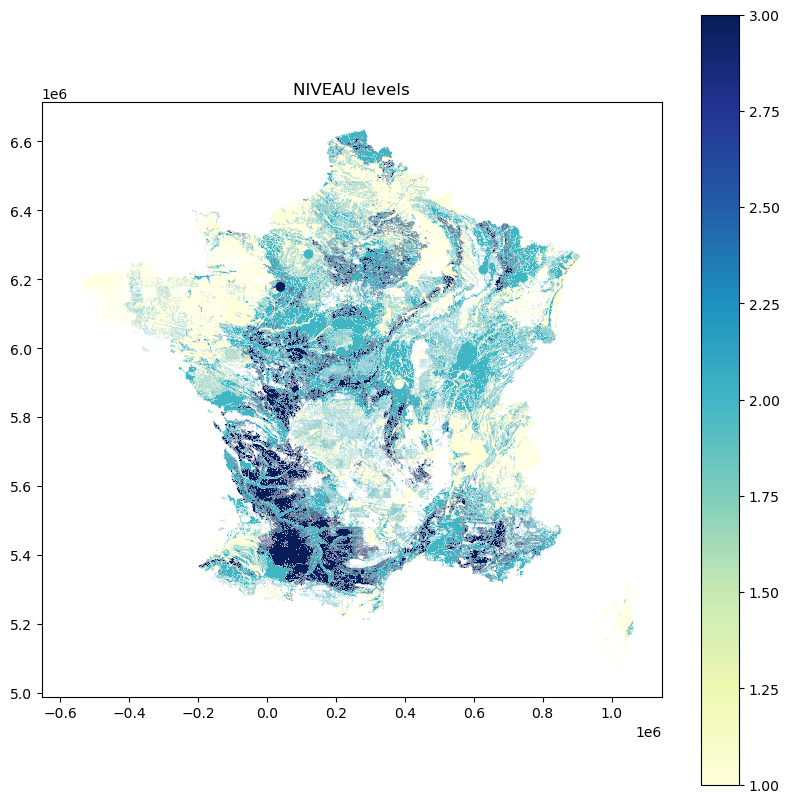

In [ ]:
# Keep only the columns you want
Expo_Argile_gdf = Expo_Argile_gdf[['ALEA', 'DPT', 'NIVEAU', 'geometry']]

# Static plotting (very light)
fig, ax = plt.subplots(figsize=(10, 10))
Expo_Argile_gdf.plot(column='NIVEAU', ax=ax, cmap='YlGnBu', legend=True)
plt.title("NIVEAU levels")
plt.show()

Ci dessus un premier graphique de la répartition de la composition en argile des sols et on peut déjà remarqué que le sud EST de la France est la zone la plus riche en argile au niveau du sol. Une bonne partie du centre et du nord présentent aussi compositions élevée en Argile.   

Enregistrement sous epsg 2154 pour la fusion

In [ ]:
print(Expo_Argile_gdf.crs)

gdf_Expo_Argile_2154 = Expo_Argile_gdf.to_crs(epsg=2154)
gdf_Expo_Argile_2154.to_file("D:/3A ENSAE/Machine Learning for climate risk/Project/Clean_Bases/Expo_Argile_2154.gpkg", layer="data", driver="GPKG")

EPSG:3857


Chargement des données ADMIN Express  sur la répartion administrative du Territoire Francais. 

Nous avons choisi pour ce projet téléchargé la versionn disponible sur data gouv qui fourni renseigne sur la répartition du territoire à l'échelle communale ce qui n'est malheureusement pas le cas avec la base récupéré via le lien fourni dans le fichier projet. Ce dernier découpe plutôt le territioire Francais en canton. 

In [22]:
import geopandas as gpd
from shapely import wkt
import duckdb

con = duckdb.connect()

con.query('INSTALL spatial')
con.query('LOAD spatial')

#gpkg_path = r"D:\3A ENSAE\Machine Learning for climate risk\Project\Data Bases\ADMIN EXPPRESS\1_DONNEES_LIVRAISON_2025-11-00136\ADE_4-0_GPKG_LAMB93_FXX-ED2025-11-20\ADE_4-0_GPKG_WGS84G_FRA-ED2025-10-15.gpkg"
gpkg_path = r"D:\3A ENSAE\Machine Learning for climate risk\Project\Data Bases\ADMIN EXPPRESS\1_DONNEES_LIVRAISON_2025-11-00136\ADE_4-0_GPKG_LAMB93_FXX-ED2025-11-20\ADE.gpkg"
# Load with DuckDB
admin_express = con.sql(f"""
    SELECT *,
           ST_AsText(geom) AS geometry_wkt
    FROM ST_Read('{gpkg_path}')
""").to_df()

# Convert WKT → Shapely geometry
admin_express["geometry"] = admin_express["geometry_wkt"].apply(wkt.loads)

# Build GeoDataFrame
gdf_admin = gpd.GeoDataFrame(admin_express, geometry="geometry")

# Assign Lambert-93 CRS (since ADMIN-EXPRESS is in LAMB93)
gdf_admin = gdf_admin.set_crs(epsg=2154)


print(gdf_admin.crs)   # should show EPSG:2154 (Lambert-93)


FloatProgress(value=0.0, layout=Layout(width='auto'), style=ProgressStyle(bar_color='black'))

EPSG:2154


In [23]:
rename_dict = {
    'codgeo': 'code_insee',
    'libgeo': 'nom_commune',
    'population': 'population',
    'can': 'code_insee_canton',
    'dept': 'code_insee_du_departement',
    'reg': 'code_insee_de_la_region',
    'superf': 'surface',
    'geometry': 'geometry'
}

gdf_admin = gdf_admin.rename(columns=rename_dict)

# Assure-toi que c'est bien un string
gdf_admin['code_insee_canton'] = gdf_admin['code_insee_canton'].astype(str)

# Extraire les 3 premiers chiffres pour les arrondissements
gdf_admin['code_insee_des_arrondissements'] = gdf_admin['code_insee_canton'].str[:3]



In [24]:
gdf_admin.head(5)

,code_insee,nom_commune,population,code_insee_canton,code_insee_du_departement,code_insee_de_la_region,surface,geom,geometry_wkt,geometry,code_insee_des_arrondissements
0,01001,L'Abergement-Clémenciat,859,0108,01,84,1590.0,"[5, 4, 0, 0, 0, 0, 0, 0, 152, 190, 78, 73, 251...","MULTIPOLYGON (((846825.5 6563787.400000001, 84...","MULTIPOLYGON (((846825.5 6563787.4, 846985.3 6...",010
1,01002,L'Abergement-de-Varey,273,0101,01,84,920.0,"[5, 4, 0, 0, 0, 0, 0, 0, 161, 80, 88, 73, 95, ...","MULTIPOLYGON (((887654.3 6545857.900000002, 88...","MULTIPOLYGON (((887654.3 6545857.9, 887175.5 6...",010
2,01004,Ambérieu-en-Bugey,15554,0101,01,84,2460.0,"[5, 4, 0, 0, 0, 0, 0, 0, 209, 230, 86, 73, 189...","MULTIPOLYGON (((881805.2 6541685.6, 881340.5 6...","MULTIPOLYGON (((881805.2 6541685.6, 881340.5 6...",010
3,01005,Ambérieux-en-Dombes,1917,0122,01,84,1590.0,"[5, 4, 0, 0, 0, 0, 0, 0, 3, 92, 78, 73, 145, 1...","MULTIPOLYGON (((845583 6544626.800000002, 8456...","MULTIPOLYGON (((845583 6544626.8, 845628.4 654...",012
4,01006,Ambléon,114,0104,01,84,590.0,"[5, 4, 0, 0, 0, 0, 0, 0, 193, 174, 91, 73, 56,...",MULTIPOLYGON (((899820.0999999999 6520340.2000...,"MULTIPOLYGON (((899820.1 6520340.2, 900065.5 6...",010


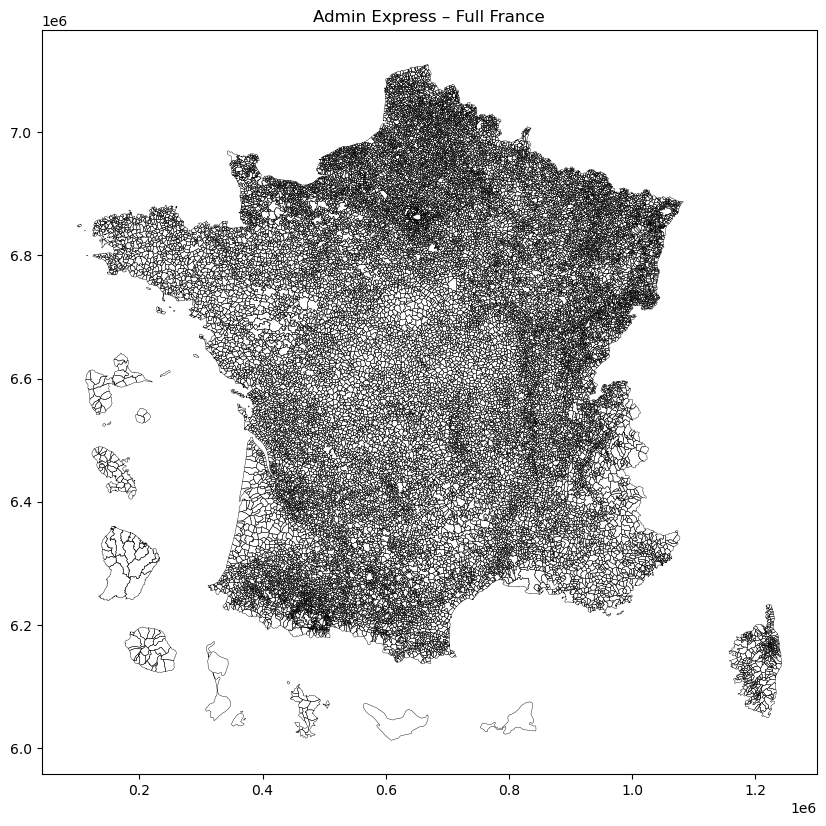

In [25]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(10, 10))
gdf_admin.plot(ax=ax, linewidth=0.3, edgecolor="black", facecolor="none")
plt.title("Admin Express – Full France")
plt.show()


In [26]:
gdf_admin_express_2154 = gdf_admin[['code_insee','nom_commune','population','code_insee_canton','code_insee_des_arrondissements','code_insee_du_departement','code_insee_de_la_region','surface','geometry']].to_crs(epsg=2154)
gdf_admin_express_2154.to_file("D:/3A ENSAE/Machine Learning for climate risk/Project/Clean_Bases/ADE_2154.gpkg", layer="data", driver="GPKG")

Nous passons maintenant à la jointure de nos bases. 

In [31]:
import geopandas as gpd

gdf_swi_unif_final=gpd.read_file("D:/3A ENSAE/Machine Learning for climate risk/Project/Clean_Bases/gdf_swi_unif_2020.gpkg")
swi_monthly_gdf=gpd.read_file("D:/3A ENSAE/Machine Learning for climate risk/Project/Clean_Bases/swi_norm_agg.gpkg")
gdf_admin_express_2154=gpd.read_file("D:/3A ENSAE/Machine Learning for climate risk/Project/Clean_Bases/ADE_2154.gpkg")
gdf_Expo_Argile_2154=gpd.read_file("D:/3A ENSAE/Machine Learning for climate risk/Project/Clean_Bases/Expo_Argile_2154.gpkg")

print(gdf_swi_unif_final.crs)
print(swi_monthly_gdf.crs)
print(gdf_admin_express_2154.crs)
print(gdf_Expo_Argile_2154.crs)

EPSG:2154
EPSG:2154
EPSG:2154
EPSG:2154


Toutes les bases sont effectivement sous l'epsg 2154

In [32]:
len(gdf_swi_unif_final)

538860

On commence par fusionner les deux bases de swi en utilisant un *sjoin_nearest* pour associer les points entre eux en fonction de leur proxilité vu qu'ils ne sont pas définies aux mêmes positions géographiques. Nous introduisons aussi un filtre sur les dates dans la fusion pour éviter les croisements entre année. 

In [46]:
import pandas as pd


# ⚠️ Les colonnes sont déjà des strings du type "YYYY-MM"
# On s'assure simplement que c'est bien du string
swi_monthly_gdf['ym'] = swi_monthly_gdf['ym'].astype(str)
gdf_swi_unif_final['DATE_YM'] = gdf_swi_unif_final['DATE_YM'].astype(str)

# 🔹 Dates communes (intersection en string)
common_dates = sorted(
    set(swi_monthly_gdf['ym']).intersection(
        set(gdf_swi_unif_final['DATE_YM'])
    )
)

# 🔹 Spatial join date par date
results = []

for dt in common_dates:
    
    # Filtrer les deux tables sur la date
    gdf_unif = gdf_swi_unif_final[gdf_swi_unif_final['DATE_YM'] == dt]
    gdf_brut = swi_monthly_gdf[swi_monthly_gdf['ym'] == dt]


    # 🔹 Créer l'index spatial une seule fois
    _ = gdf_brut.sindex  # GeoPandas va réutiliser cet index pour le sjoin

    
    # Join spatiale (nearest)
    merged_dt = gpd.sjoin_nearest(
        gdf_unif,
        gdf_brut,
        how="inner",
        distance_col="dist_m"
    )

    results.append(merged_dt)

# 🔹 Concaténation finale
swi_brut_uniform_merged = pd.concat(results).reset_index(drop=True)
#swi_brut_uniform_merged.to_file("/home/onyxia/work/Clean_Bases/swi_brut_uniform_merged_2154.gpkg", layer="data", driver="GPKG")

In [47]:
swi_brut_uniform_merged['dist_m'].describe()

count    538860.000000
mean          0.755994
std           0.286492
min           0.014929
25%           0.551905
50%           0.790092
75%           0.969164
max           1.405003
Name: dist_m, dtype: float64

Cette première fusion sembre s'étre bien déroulé puisque toutes lignes de droites ont été conservé. 

Nous avons évalué les distances entre les points les plus proches entre les bases du swi et du swi uniforme au moment de la fusion et l'écart est faible. Nous avons un écart maximum de 1.4m ce qui témoigne du fait que la marge d'erreur assumé par la fusion par plus proche voisin est négigeable. 

Nous fusionons maintenant ce premier bloc avec la base renseignant sur la composition en argile des sols. 

In [48]:
# Il s'agit ici d'avoir AdminExpress + ExpoArgile + swi_uniform + swi_daily_agrégegé_par_mois

# Admin_express with Expo_Argile = admin_with_clay
_ = gdf_Expo_Argile_2154.sindex
swi_with_clay = gpd.sjoin(
    swi_brut_uniform_merged,
    gdf_Expo_Argile_2154,
    how='left',
    predicate='within',
    rsuffix='_rga'
)


#Reset index
swi_with_clay = swi_with_clay.reset_index(drop=True)

# Remplacement des NA après fusion
swi_with_clay['ALEA'] = swi_with_clay['ALEA'].fillna('Non Exposé')
swi_with_clay['NIVEAU'] = swi_with_clay['NIVEAU'].fillna(0).astype(int)

In [49]:
swi_with_clay.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 538860 entries, 0 to 538859
Data columns (total 45 columns):
 #   Column           Non-Null Count   Dtype   
---  ------           --------------   -----   
 0   NUMERO           538860 non-null  int64   
 1   LAMBX_left       538860 non-null  int64   
 2   LAMBY_left       538860 non-null  int64   
 3   DATE_YM          538860 non-null  object  
 4   SWI_UNIF_MENS    538860 non-null  float64 
 5   geometry         538860 non-null  geometry
 6   index_right      538860 non-null  int64   
 7   LAMBX_right      538860 non-null  int64   
 8   LAMBY_right      538860 non-null  int64   
 9   ym               538860 non-null  object  
 10  swi_min          538860 non-null  float64 
 11  swi_mean         538860 non-null  float64 
 12  swi_max          538860 non-null  float64 
 13  sswi10j_avg      538860 non-null  float64 
 14  prenei_sum       538860 non-null  float64 
 15  preliq_sum       538860 non-null  float64 
 16  pe_sum      

In [50]:
swi_with_clay.head(3)

,NUMERO,LAMBX_left,LAMBY_left,DATE_YM,SWI_UNIF_MENS,geometry,index_right,LAMBX_right,LAMBY_right,ym,...,ecoulement_sum,wg_racine_avg,wgi_racine_avg,LAMBX_m,LAMBY_m,dist_m,index__rga,ALEA,DPT,NIVEAU
0,2,641374,7106309,2020-01,0.949,POINT (641374 7106309),250020,5880,26730,2020-01,...,0.0,0.293097,0.0,588000,2673000,0.449773,NaN,Non Exposé,NaN,0
1,3,649370,7106242,2020-01,0.949,POINT (649370 7106242),257280,5960,26730,2020-01,...,0.0,0.281935,0.0,596000,2673000,0.555713,NaN,Non Exposé,NaN,0
2,4,657366,7106175,2020-01,0.950,POINT (657366 7106175),264600,6040,26730,2020-01,...,0.0,0.317097,0.0,604000,2673000,0.616402,NaN,Non Exposé,NaN,0


On passe enfin à la fusion du bloc précédent avec ADMIN EXPRESS

In [55]:
#/home/onyxia/work/Project_code.ipynb

# gdf_points = gpd.read_file("/home/onyxia/work/swi_brut_uniform_merged_2154.gpkg")
# swi_with_clay_2023 = swi_brut_uniform_merged[swi_brut_uniform_merged["ym"] <= "2023-12"]
# swi_with_clay_2023 = swi_with_clay_2023[swi_with_clay_2023["ym"] >= "2023-01"]

_ = gdf_admin_express_2154.sindex
final_data = gpd.sjoin( 
    swi_with_clay,# à gauche
    gdf_admin_express_2154, # à droite
    how="inner",
    predicate="within",
    rsuffix='_adm'
)

final_data=final_data.reset_index(drop=True)

In [56]:
final_data.head(3)

,NUMERO,LAMBX_left,LAMBY_left,DATE_YM,SWI_UNIF_MENS,geometry,index_right,LAMBX_right,LAMBY_right,ym,...,NIVEAU,index__adm,code_insee,nom_commune,population,code_insee_canton,code_insee_des_arrondissements,code_insee_du_departement,code_insee_de_la_region,surface
0,4,657366,7106175,2020-01,0.950,POINT (657366 7106175),264600,6040,26730,2020-01,...,0,21928,59183,Dunkerque,87013,5996,599,59,32,4390.0
1,5,665362,7106108,2020-01,0.949,POINT (665362 7106108),271920,6120,26730,2020-01,...,2,22002,59260,Ghyvelde,4126,5917,591,59,32,3590.0
2,13,625315,7098447,2020-01,0.957,POINT (625315 7098447),235500,5720,26650,2020-01,...,2,23994,62548,Marck,10468,6234,623,62,32,3160.0


In [57]:
final_data.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 515100 entries, 0 to 515099
Data columns (total 54 columns):
 #   Column                          Non-Null Count   Dtype   
---  ------                          --------------   -----   
 0   NUMERO                          515100 non-null  int64   
 1   LAMBX_left                      515100 non-null  int64   
 2   LAMBY_left                      515100 non-null  int64   
 3   DATE_YM                         515100 non-null  object  
 4   SWI_UNIF_MENS                   515100 non-null  float64 
 5   geometry                        515100 non-null  geometry
 6   index_right                     515100 non-null  int64   
 7   LAMBX_right                     515100 non-null  int64   
 8   LAMBY_right                     515100 non-null  int64   
 9   ym                              515100 non-null  object  
 10  swi_min                         515100 non-null  float64 
 11  swi_mean                        515100 non-null  float64 

Vérification de valeurs manquantes

In [58]:
final_data.isna().sum()

NUMERO                                 0
LAMBX_left                             0
LAMBY_left                             0
DATE_YM                                0
SWI_UNIF_MENS                          0
geometry                               0
index_right                            0
LAMBX_right                            0
LAMBY_right                            0
ym                                     0
swi_min                                0
swi_mean                               0
swi_max                                0
sswi10j_avg                            0
prenei_sum                             0
preliq_sum                             0
pe_sum                                 0
evap_sum                               0
t_avg                                  0
ff_avg                                 0
q_avg                                  0
hu_avg                                 0
dli_avg                                0
ssi_avg                                0
etp_avg         

La fusion semble s'être bien déroulé.  Pas de valeurs manquantes sur les variables les plus importantes. Les valeurs manquantes observées sont tout à fait jutifiées. Ils proviennent du traitement appliqué après fusion avec la base de la compostion des sols en argile pour couvrir les zones non couvertes par la base. 

In [63]:
final_data.head(3)

,SWI_UNIF_MENS,geometry,ym,swi_min,swi_mean,swi_max,prenei_sum,preliq_sum,pe_sum,evap_sum,...,NIVEAU,index__adm,code_insee,nom_commune,population,code_insee_canton,code_insee_des_arrondissements,code_insee_du_departement,code_insee_de_la_region,surface
0,0.950,POINT (657366 7106175),2020-01,0.851,0.894806,0.950,0.0,48.2,27.0,21.2,...,0,21928,59183,Dunkerque,87013,5996,599,59,32,4390.0
1,0.949,POINT (665362 7106108),2020-01,0.861,0.902290,0.956,0.0,48.2,29.5,18.7,...,2,22002,59260,Ghyvelde,4126,5917,591,59,32,3590.0
2,0.957,POINT (625315 7098447),2020-01,0.858,0.904290,0.956,0.0,45.3,24.5,20.8,...,2,23994,62548,Marck,10468,6234,623,62,32,3160.0


Suppression de variables présnetes en doublons ou jugées inutiles à la suite de la fusion pour le reste du travail. 

In [64]:
# liste des colonnes à supprimer
cols_to_drop = [
    "NUMERO",
    "DATE_YM",
    "LAMBX_left", "LAMBY_left",
    "LAMBX_right", "LAMBY_right",
    "index_right",
    "LAMBX_m", "LAMBY_m",
    "sswi10j_avg",
    "dist_m",
    "index__rga",
    "index_adm",
    "DPT"
]

# suppression des colonnes (ignore celles qui n'existent pas)
final_data = final_data.drop(
    columns=cols_to_drop,
    errors="ignore"
)

# vérification rapide
final_data.info()


<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 515100 entries, 0 to 515099
Data columns (total 41 columns):
 #   Column                          Non-Null Count   Dtype   
---  ------                          --------------   -----   
 0   SWI_UNIF_MENS                   515100 non-null  float64 
 1   geometry                        515100 non-null  geometry
 2   ym                              515100 non-null  object  
 3   swi_min                         515100 non-null  float64 
 4   swi_mean                        515100 non-null  float64 
 5   swi_max                         515100 non-null  float64 
 6   prenei_sum                      515100 non-null  float64 
 7   preliq_sum                      515100 non-null  float64 
 8   pe_sum                          515100 non-null  float64 
 9   evap_sum                        515100 non-null  float64 
 10  t_avg                           515100 non-null  float64 
 11  ff_avg                          515100 non-null  float64 

Labélisation des départements et régions pour de meilleurs analyses et représentation graphique. 

In [65]:
# Dictionary: INSEE code -> department name
insee_dept_dict = {
    "01": "Ain",
    "02": "Aisne",
    "03": "Allier",
    "04": "Alpes-de-Haute-Provence",
    "05": "Hautes-Alpes",
    "06": "Alpes-Maritimes",
    "07": "Ardèche",
    "08": "Ardennes",
    "09": "Ariège",
    "10": "Aube",
    "11": "Aude",
    "12": "Aveyron",
    "13": "Bouches-du-Rhône",
    "14": "Calvados",
    "15": "Cantal",
    "16": "Charente",
    "17": "Charente-Maritime",
    "18": "Cher",
    "19": "Corrèze",
    "2A": "Corse-du-Sud",
    "2B": "Haute-Corse",
    "21": "Côte-d'Or",
    "22": "Côtes-d'Armor",
    "23": "Creuse",
    "24": "Dordogne",
    "25": "Doubs",
    "26": "Drôme",
    "27": "Eure",
    "28": "Eure-et-Loir",
    "29": "Finistère",
    "30": "Gard",
    "31": "Haute-Garonne",
    "32": "Gers",
    "33": "Gironde",
    "34": "Hérault",
    "35": "Ille-et-Vilaine",
    "36": "Indre",
    "37": "Indre-et-Loire",
    "38": "Isère",
    "39": "Jura",
    "40": "Landes",
    "41": "Loir-et-Cher",
    "42": "Loire",
    "43": "Haute-Loire",
    "44": "Loire-Atlantique",
    "45": "Loiret",
    "46": "Lot",
    "47": "Lot-et-Garonne",
    "48": "Lozère",
    "49": "Maine-et-Loire",
    "50": "Manche",
    "51": "Marne",
    "52": "Haute-Marne",
    "53": "Mayenne",
    "54": "Meurthe-et-Moselle",
    "55": "Meuse",
    "56": "Morbihan",
    "57": "Moselle",
    "58": "Nièvre",
    "59": "Nord",
    "60": "Oise",
    "61": "Orne",
    "62": "Pas-de-Calais",
    "63": "Puy-de-Dôme",
    "64": "Pyrénées-Atlantiques",
    "65": "Hautes-Pyrénées",
    "66": "Pyrénées-Orientales",
    "67": "Bas-Rhin",
    "68": "Haut-Rhin",
    "69": "Rhône",
    "70": "Haute-Saône",
    "71": "Saône-et-Loire",
    "72": "Sarthe",
    "73": "Savoie",
    "74": "Haute-Savoie",
    "75": "Paris",
    "76": "Seine-Maritime",
    "77": "Seine-et-Marne",
    "78": "Yvelines",
    "79": "Deux-Sèvres",
    "80": "Somme",
    "81": "Tarn",
    "82": "Tarn-et-Garonne",
    "83": "Var",
    "84": "Vaucluse",
    "85": "Vendée",
    "86": "Vienne",
    "87": "Haute-Vienne",
    "88": "Vosges",
    "89": "Yonne",
    "90": "Territoire de Belfort",
    "91": "Essonne",
    "92": "Hauts-de-Seine",
    "93": "Seine-Saint-Denis",
    "94": "Val-de-Marne",
    "95": "Val-d'Oise",
    "971": "Guadeloupe",
    "972": "Martinique",
    "973": "Guyane",
    "974": "La Réunion",
    "976": "Mayotte"
}

final_data["dept_name"] = final_data["code_insee_du_departement"].map(insee_dept_dict)

insee_region_dict = {
    "01": "Guadeloupe",
    "02": "Martinique",
    "03": "Guyane",
    "04": "La Réunion",
    "06": "Mayotte",
    "11": "Île-de-France",
    "24": "Centre-Val de Loire",
    "27": "Bourgogne-Franche-Comté",
    "28": "Normandie",
    "32": "Hauts-de-France",
    "44": "Grand Est",
    "52": "Pays de la Loire",
    "53": "Bretagne",
    "75": "Nouvelle-Aquitaine",
    "76": "Occitanie",
    "84": "Auvergne-Rhône-Alpes",
    "93": "Provence-Alpes-Côte d'Azur",
    "94": "Corse"
}

final_data["region_name"] = final_data["code_insee_de_la_region"].map(insee_region_dict)

In [67]:
final_data.to_file("D:/3A ENSAE/Machine Learning for climate risk/Project/Clean_Bases/final_data_20_24.gpkg", layer="data", driver="GPKG")

<h3 style="
    color:#4F8DF7; 
    font-family: 'Segoe UI', Arial, sans-serif;
    margin-top: 20px;
    margin-bottom: 12px;
">
    B. Analyse quantitative
</h3>


In [81]:
import pandas as pd

cols = ["SWI_UNIF_MENS", "swi_mean"]
years = sorted(final_data["year"].unique())

for year in years:
    print(f"\n===== Statistiques pour l'année {year} =====\n")
    summary = final_data[final_data["year"] == year][cols].agg(['mean', 'std', 'min', 'max'])
    print(summary)



===== Statistiques pour l'année 2020 =====

      SWI_UNIF_MENS  swi_mean
mean       0.572422  0.621762
std        0.346337  0.282759
min       -0.037000 -0.011968
max        1.391000  1.504033

===== Statistiques pour l'année 2021 =====

      SWI_UNIF_MENS  swi_mean
mean       0.616854  0.667917
std        0.292413  0.228260
min       -0.041000 -0.018433
max        1.443000  1.592161

===== Statistiques pour l'année 2022 =====

      SWI_UNIF_MENS  swi_mean
mean       0.454530  0.519588
std        0.339235  0.281576
min       -0.039000 -0.019419
max        1.358000  1.577633

===== Statistiques pour l'année 2023 =====

      SWI_UNIF_MENS  swi_mean
mean       0.575530  0.635228
std        0.341488  0.277929
min       -0.032000 -0.009161
max        1.425000  1.520467

===== Statistiques pour l'année 2024 =====

      SWI_UNIF_MENS  swi_mean
mean       0.720892  0.754652
std        0.288295  0.225286
min       -0.034000 -0.016484
max        1.387000  1.545645


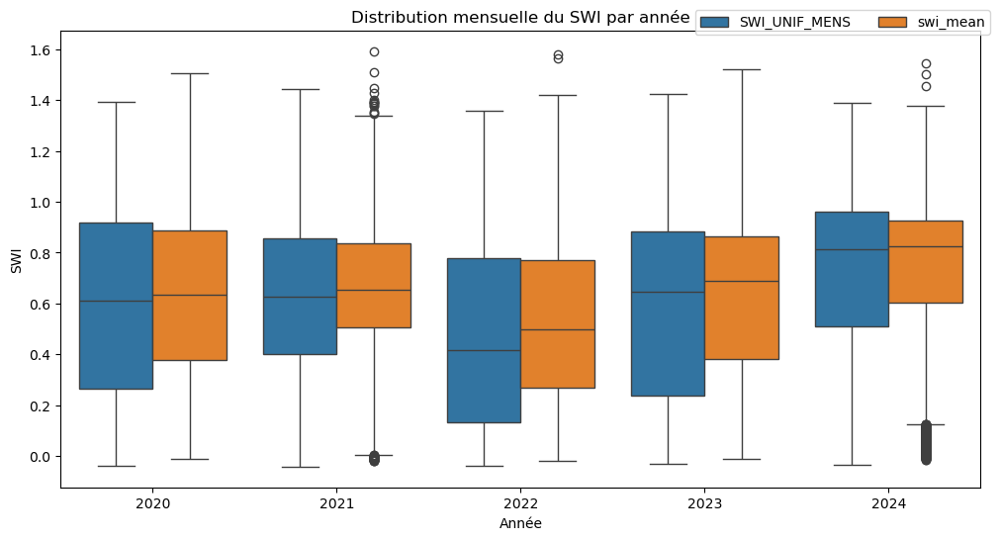

In [88]:
import matplotlib.pyplot as plt
import seaborn as sns

cols = ["SWI_UNIF_MENS", "swi_mean"]

# Préparer les données pour seaborn
melted = final_data.melt(
    id_vars="year",
    value_vars=cols,
    var_name="Variable",
    value_name="SWI"
)

plt.figure(figsize=(12, 6))
sns.boxplot(x="year", y="SWI", hue="Variable", data=melted)

plt.title("Distribution mensuelle du SWI par année")
plt.ylabel("SWI")
plt.xlabel("Année")

# Déplacer la légende au-dessus
plt.legend(title="", loc='upper center', bbox_to_anchor=(0.85, 1.06), ncol=2)
plt.show()


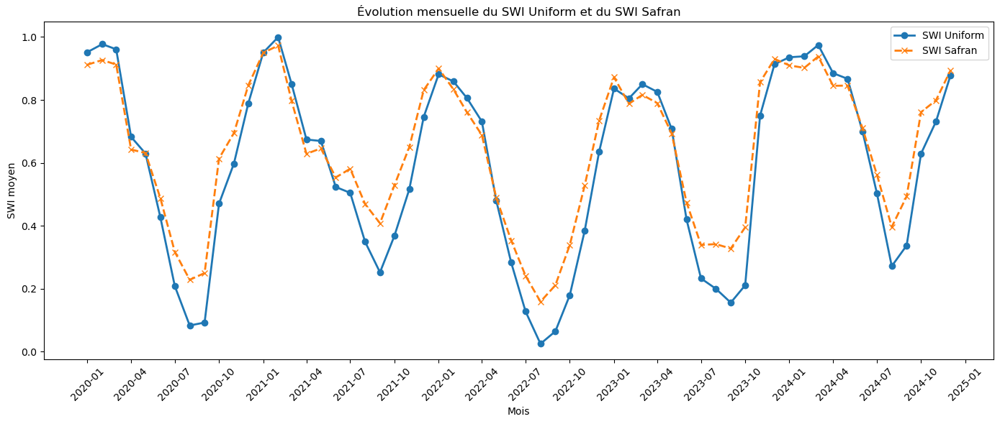

In [77]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import pandas as pd

# -------------------------
# 1️⃣ Conversion de ym en datetime
# -------------------------
final_data["date"] = pd.to_datetime(final_data["ym"], format="%Y-%m")

# -------------------------
# 2️⃣ Calcul des moyennes par mois
# -------------------------
monthly_mean = (
    final_data
    .groupby("date")[["SWI_UNIF_MENS", "swi_mean"]]
    .mean()
    .reset_index()
)

# -------------------------
# 3️⃣ Graphique
# -------------------------
plt.figure(figsize=(14, 6))

# Courbe SWI uniforme
plt.plot(
    monthly_mean["date"],
    monthly_mean["SWI_UNIF_MENS"],
    marker='o',
    label="SWI Uniform",
    linewidth=2
)

# Courbe SWI Safran moyen
plt.plot(
    monthly_mean["date"],
    monthly_mean["swi_mean"],
    marker='x',
    linestyle='--',
    label="SWI Safran",
    linewidth=2
)

# -------------------------
# 4️⃣ Axe X en format YYYY-MM
# -------------------------
plt.gca().xaxis.set_major_locator(
    mdates.MonthLocator(bymonth=[1, 4, 7, 10])
)
plt.gca().xaxis.set_major_formatter(
    mdates.DateFormatter("%Y-%m")
)

plt.xticks(rotation=45)
plt.xlabel("Mois")
plt.ylabel("SWI moyen")
plt.title("Évolution mensuelle du SWI Uniform et du SWI Safran")
plt.legend()
plt.tight_layout()
plt.show()


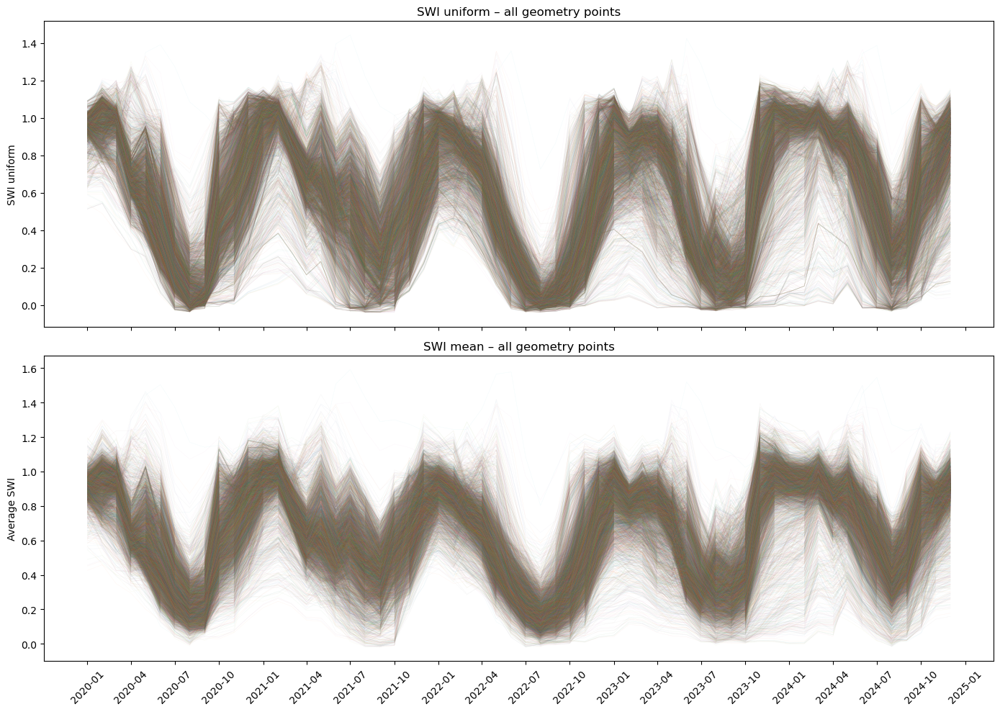

In [68]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import pandas as pd

# Conversion des dates une seule fois (plus propre)
final_data["date"] = pd.to_datetime(final_data["ym"], format="%Y-%m")

fig, axes = plt.subplots(
    nrows=2,
    ncols=1,
    figsize=(14, 10),
    sharex=True
)

# =========================
# 1️⃣ SWI_UNIF_MENS
# =========================
ax1 = axes[0]

for _, g in final_data.groupby("geometry"):
    ax1.plot(
        g["date"],
        g["SWI_UNIF_MENS"],
        linewidth=0.4,
        alpha=0.05
    )

ax1.set_ylabel("SWI uniform")
ax1.set_title("SWI uniform – all geometry points")

# =========================
# 2️⃣ SWI moyen
# =========================
ax2 = axes[1]

for _, g in final_data.groupby("geometry"):
    ax2.plot(
        g["date"],
        g["swi_mean"],
        linewidth=0.4,
        alpha=0.05
    )

ax2.set_ylabel("Average SWI")
ax2.set_title("SWI mean – all geometry points")

# =========================
# Axe X commun
# =========================
ax2.xaxis.set_major_locator(
    mdates.MonthLocator(bymonth=[1, 4, 7, 10])
)
ax2.xaxis.set_major_formatter(
    mdates.DateFormatter("%Y-%m")
)

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


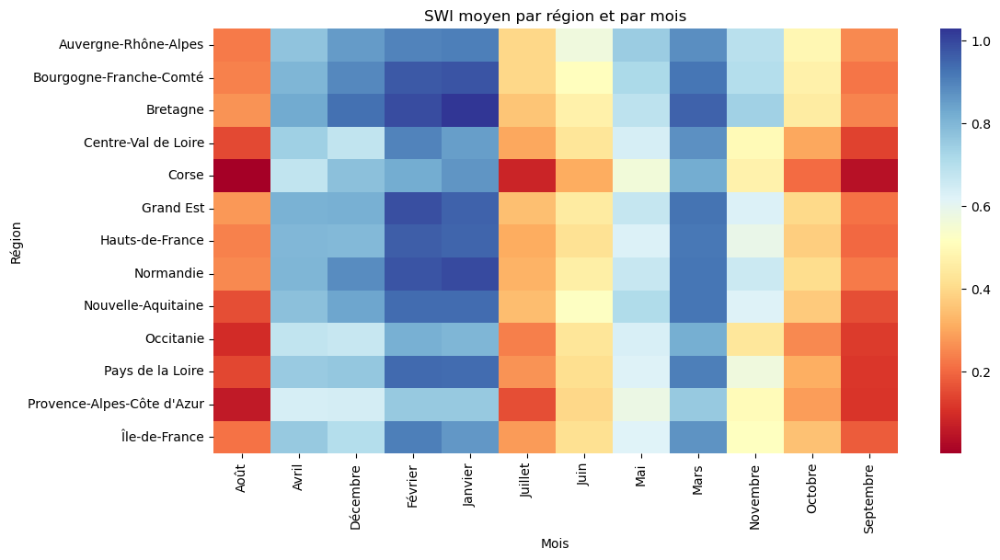

In [75]:
# 1️⃣ Extraire le mois en string
final_data["month_num"] = final_data["ym"].str[-2:]  # les deux derniers caractères

# 2️⃣ Créer un mapping mois → lettres
month_map = {
    "01": "Janvier",
    "02": "Février",
    "03": "Mars",
    "04": "Avril",
    "05": "Mai",
    "06": "Juin",
    "07": "Juillet",
    "08": "Août",
    "09": "Septembre",
    "10": "Octobre",
    "11": "Novembre",
    "12": "Décembre"
}

# 3️⃣ Appliquer le mapping
final_data["month"] = final_data["month_num"].map(month_map)

# 4️⃣ (Optionnel) Supprimer la colonne intermédiaire
final_data = final_data.drop(columns=["month_num"])


# b) Moyenne mensuelle régionale
regional_monthly = (
    final_data
    .groupby([region_name, "month"])["SWI_UNIF_MENS"]
    .mean()
    .reset_index()
)


import seaborn as sns

heatmap_df = regional_monthly.pivot(
    index=region_name,
    columns="month",
    values="SWI_UNIF_MENS"
)

plt.figure(figsize=(12, 6))
sns.heatmap(
    heatmap_df,
    cmap="RdYlBu",
    annot=False
)

plt.title("SWI moyen par région et par mois")
plt.xlabel("Mois")
plt.ylabel("Région")
plt.show()


<h3 style="
    color:#4F8DF7; 
    font-family: 'Segoe UI', Arial, sans-serif;
    margin-top: 20px;
    margin-bottom: 12px;
">
    C. Quantitative Regional Drought Insights
</h3>


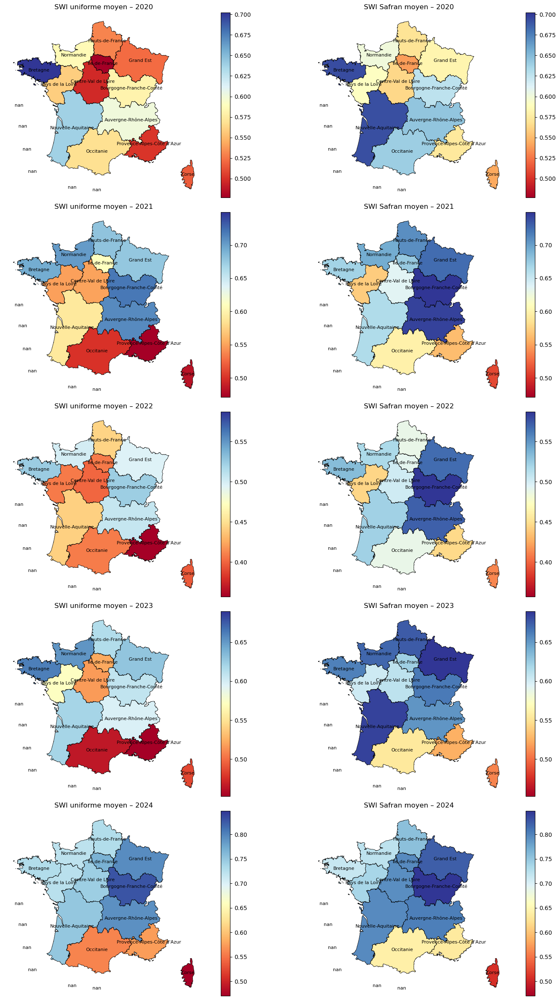

In [89]:
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt

# =========================
# 1️⃣ Préparation des données points
# =========================
final_data["year"] = final_data["ym"].str[:4].astype(int)

# =========================
# 2️⃣ Chargement des communes
# =========================
admin_communes = gpd.read_file(
    "D:/3A ENSAE/Machine Learning for climate risk/Project/Clean_Bases/ADE_2154.gpkg"
).to_crs("EPSG:2154")

admin_communes = admin_communes[["code_insee_de_la_region", "geometry"]]

# =========================
# 3️⃣ Construction des régions (DISSOLVE)
# =========================
regions_gdf = admin_communes.dissolve(
    by="code_insee_de_la_region",
    as_index=False
)

# =========================
# 4️⃣ Ajout du nom de région (DEPUIS final_data)
# =========================
region_names = (
    final_data[["code_insee_de_la_region", "region_name"]]
    .drop_duplicates(subset="code_insee_de_la_region")
)

regions_gdf = regions_gdf.merge(
    region_names,
    on="code_insee_de_la_region",
    how="left"
)

# =========================
# 5️⃣ Point de label (1 par région)
# =========================
regions_gdf["label_point"] = regions_gdf.geometry.representative_point()

# =========================
# 6️⃣ Cartes annuelles avec 2 colonnes, échelle commune
# =========================
years = range(2020, 2025)
fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(16, 24))

for i, year in enumerate(years):

    # ---- Moyenne régionale annuelle
    regional_uniform = (
        final_data[final_data["year"] == year]
        .groupby("code_insee_de_la_region")["SWI_UNIF_MENS"]
        .mean()
        .reset_index()
    )

    regional_safran = (
        final_data[final_data["year"] == year]
        .groupby("code_insee_de_la_region")["swi_mean"]
        .mean()
        .reset_index()
    )

    # ---- Déterminer vmin / vmax commun pour l'année
    vmin = min(regional_uniform["SWI_UNIF_MENS"].min(), regional_safran["swi_mean"].min())
    vmax = max(regional_uniform["SWI_UNIF_MENS"].max(), regional_safran["swi_mean"].max())

    # ---- Jointure avec les régions
    map_uniform = regions_gdf.merge(regional_uniform, on="code_insee_de_la_region", how="left")
    map_safran = regions_gdf.merge(regional_safran, on="code_insee_de_la_region", how="left")

    # ---- Carte SWI_UNIF_MENS (colonne gauche)
    ax1 = axes[i, 0]
    map_uniform.plot(column="SWI_UNIF_MENS", cmap="RdYlBu", legend=True,
                     edgecolor="black", linewidth=0.6, ax=ax1, vmin=vmin, vmax=vmax)
    for _, row in regions_gdf.iterrows():
        ax1.text(row["label_point"].x, row["label_point"].y,
                 row["region_name"], fontsize=8, ha="center", va="center")
    ax1.set_title(f"SWI uniforme moyen – {year}", fontsize=12)
    ax1.axis("off")

    # ---- Carte swi_mean (colonne droite)
    ax2 = axes[i, 1]
    map_safran.plot(column="swi_mean", cmap="RdYlBu", legend=True,
                    edgecolor="black", linewidth=0.6, ax=ax2, vmin=vmin, vmax=vmax)
    for _, row in regions_gdf.iterrows():
        ax2.text(row["label_point"].x, row["label_point"].y,
                 row["region_name"], fontsize=8, ha="center", va="center")
    ax2.set_title(f"SWI Safran moyen – {year}", fontsize=12)
    ax2.axis("off")

plt.tight_layout()
plt.show()


<h3 style="
    color:#4F8DF7; 
    font-family: 'Segoe UI', Arial, sans-serif;
    margin-top: 20px;
    margin-bottom: 12px;
">
    D. Analyse de la relation entre le SWI et le SWI uniforme
</h3>


In [90]:
import pandas as pd

corr_matrix = final_data[["swi_mean", "SWI_UNIF_MENS"]].corr(method="pearson")
corr_matrix = corr_matrix.round(3)  # arrondir pour la lisibilité

print("Matrice de corrélation (Pearson) :")
print(corr_matrix)


Matrice de corrélation (Pearson) :
               swi_mean  SWI_UNIF_MENS
swi_mean          1.000          0.964
SWI_UNIF_MENS     0.964          1.000


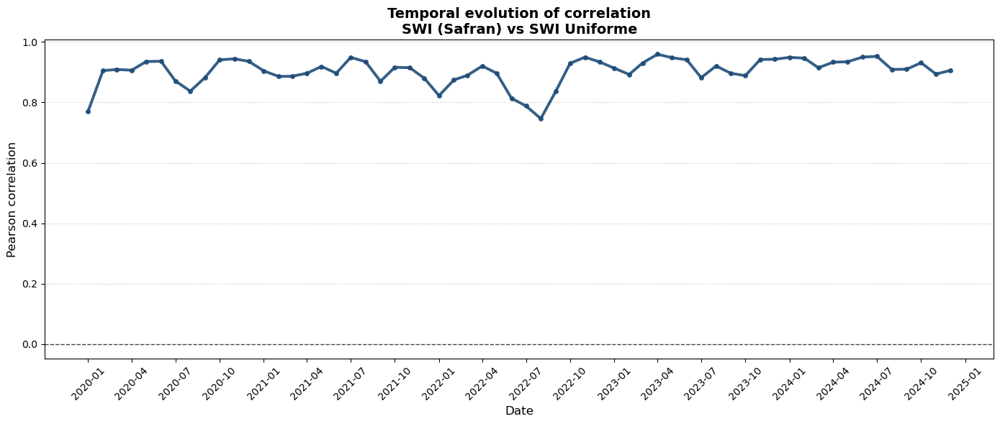

In [91]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# Conversion en datetime
df = final_data.copy()
df["ym_dt"] = pd.to_datetime(df["ym"], format="%Y-%m")

# Corrélation mensuelle sur toutes les géométries
corr_ts = (
    df
    .groupby("ym_dt")[["swi_mean", "SWI_UNIF_MENS"]]
    .corr()
    .iloc[0::2, -1]  # extrait corr(swi_mean, SWI_UNIF_MENS)
    .reset_index()
)

corr_ts = corr_ts.rename(columns={"SWI_UNIF_MENS": "corr"})

import matplotlib.pyplot as plt
import matplotlib.dates as mdates

fig, ax = plt.subplots(figsize=(14, 6))

ax.plot(
    corr_ts["ym_dt"],
    corr_ts["corr"],
    color="#1f4e79",        # bleu sobre
    linewidth=2.8,
    marker="o",
    markersize=4,
    alpha=0.9
)

# Axe du temps : trimestres
ax.xaxis.set_major_locator(mdates.MonthLocator(bymonth=[1, 4, 7, 10]))
ax.xaxis.set_major_formatter(mdates.DateFormatter("%Y-%m"))

# Ligne zéro
ax.axhline(0, color="black", linestyle="--", linewidth=1, alpha=0.7)

# Grille légère
ax.grid(
    which="major",
    axis="y",
    linestyle="--",
    linewidth=0.8,
    alpha=0.4
)

# Labels
ax.set_xlabel("Date", fontsize=12)
ax.set_ylabel("Pearson correlation", fontsize=12)
ax.set_title(
    "Temporal evolution of correlation\nSWI (Safran) vs SWI Uniforme",
    fontsize=14,
    weight="bold"
)

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [92]:
corr_by_geom = (
    final_data
    .groupby("geometry")[["swi_mean", "SWI_UNIF_MENS"]]
    .corr()
    .iloc[0::2, -1]   # select swi_mean vs SWI_UNIF_MENS
    .reset_index()
    .drop(columns="level_1")  # remove the unnecessary column
    .rename(columns={"SWI_UNIF_MENS": "corr_pearson"})
)

corr_by_geom["corr_pearson"].describe()


count    8585.000000
mean        0.974671
std         0.015975
min         0.888244
25%         0.964413
50%         0.978556
75%         0.987409
max         0.998627
Name: corr_pearson, dtype: float64

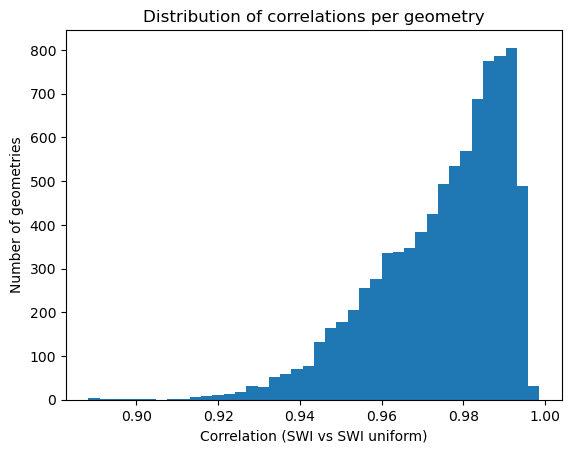

In [93]:
import matplotlib.pyplot as plt

plt.hist(corr_by_geom["corr_pearson"], bins=40)
plt.xlabel("Correlation (SWI vs SWI uniform)")
plt.ylabel("Number of geometries")
plt.title("Distribution of correlations per geometry")
plt.show()


In [98]:
# Keep only one row per geometry with the additional info
geo_data = final_data[["geometry", "dept_name", "region_name", "nom_commune"]].drop_duplicates()

# Merge correlation
geo_data = geo_data.merge(
    corr_by_geom,           # has geometry + corr_pearson
    on="geometry",
    how="left"
)


import geopandas as gpd

geo_data.explore(
    column="corr_pearson",       # color points by correlation
    cmap="viridis",
    tooltip=["dept_name", "region_name", "nom_commune", "corr_pearson"],  # info on hover
    marker_kwds={"radius": 2.5},   # size of points
    legend=True
)


In [99]:
# Aggregate by geometry: mean SWI and mean SWI_UNIF per point
geo_diff = (
    final_data.groupby("geometry")[["swi_mean", "SWI_UNIF_MENS"]]
    .mean()  # average over time if multiple observations per geometry
    .reset_index()
)

# Compute absolute difference
geo_diff["abs_diff"] = abs(geo_diff["swi_mean"] - geo_diff["SWI_UNIF_MENS"])

# Merge metadata (department, region, official name)
meta = final_data[["geometry", "dept_name", "region_name", "nom_commune"]].drop_duplicates()
geo_diff = geo_diff.merge(meta, on="geometry", how="left")

import geopandas as gpd

# If geo_diff is a plain DataFrame, convert it
geo_diff = gpd.GeoDataFrame(geo_diff, geometry="geometry")

# Make sure CRS is set (example: EPSG 2154 or whatever your data uses)
geo_diff.set_crs(epsg=2154, inplace=True)



geo_diff.explore(
    column="abs_diff",                 # color points by absolute difference
    cmap="Reds",                       # red = large difference
    tooltip=["dept_name", "region_name", "nom_commune", "abs_diff"],  # info on hover
    marker_kwds={"radius": 2.5},         # point size
    legend=True
)


In [100]:
q75 = geo_diff["abs_diff"].quantile(0.75)

q75


np.float64(0.08342585990606854)

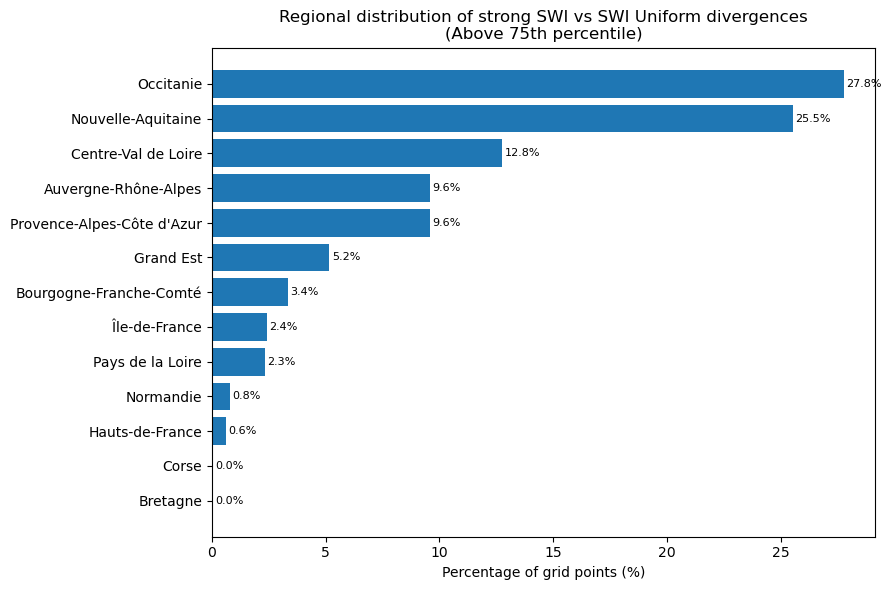

In [102]:
geo_diff_q75 = geo_diff[geo_diff["abs_diff"] >= q75].copy()
geo_diff_q75.reset_index(drop=True, inplace=True)

region_share = (
    geo_diff_q75
    .groupby("region_name")
    .size()
    .reset_index(name="n_points")
)

region_share["percentage"] = (
    100 * region_share["n_points"] / region_share["n_points"].sum()
)

top_regions = (
    region_share
    .sort_values("percentage", ascending=False)
    .head(30)   # il y aura de toute façon < 30 régions
)


import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(9, 6))

ax.barh(
    top_regions["region_name"][::-1],
    top_regions["percentage"][::-1]
)

ax.set_xlabel("Percentage of grid points (%)")
ax.set_title(
    "Regional distribution of strong SWI vs SWI Uniform divergences\n"
    "(Above 75th percentile)"
)

# Labels de valeur
for i, v in enumerate(top_regions["percentage"][::-1]):
    ax.text(v + 0.1, i, f"{v:.1f}%", va="center", fontsize=8)

plt.tight_layout()
plt.show()


In [108]:
import geopandas as gpd

# =========================
# 1️⃣ Filtrage temporel (1 année de référence)
# =========================
YEAR_REF = 2022

gdf_alea = (
    final_data[final_data["year"] == YEAR_REF]
    .loc[:, ["geometry", "ALEA", "dept_name", "region_name", "nom_commune"]]
    .drop_duplicates(subset="geometry")   # sécurité supplémentaire
    .copy()
)

# =========================
# 2️⃣ Conversion en GeoDataFrame
# =========================
gdf_alea = gpd.GeoDataFrame(
    gdf_alea,
    geometry="geometry",
    crs=final_data.crs
)

# =========================
# 3️⃣ Carte interactive ALEA
# =========================
gdf_alea.explore(
    column="ALEA",
    categorical=True,
    legend=True,
    tooltip=[
        "region_name",
        "dept_name",
        "nom_commune",
        "ALEA"
    ],
    marker_kwds={
        "radius": 2.5,
        "fillOpacity": 0.7
    },
    tiles="CartoDB positron"
)


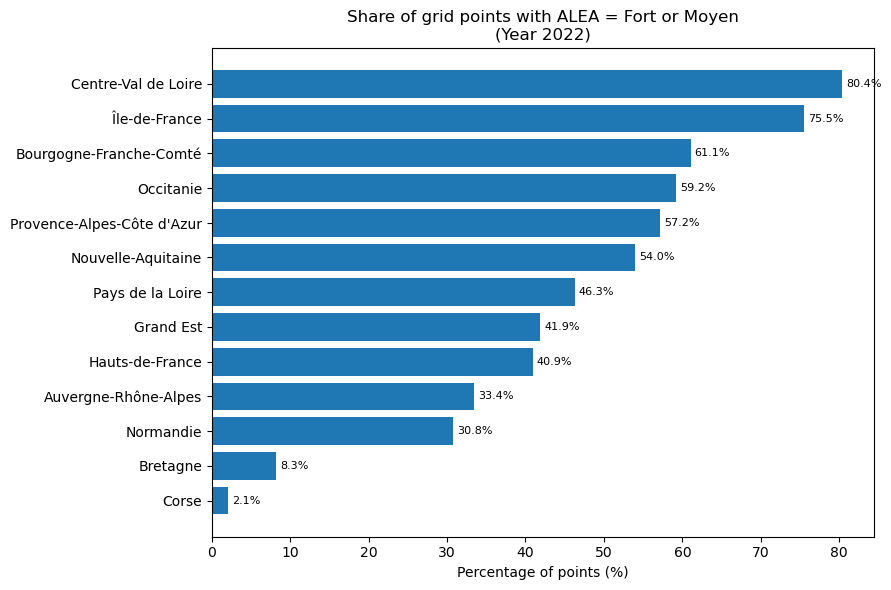

In [109]:
import pandas as pd

# Total de points par région
total_points = (
    gdf_alea
    .groupby("region_name")
    .size()
    .reset_index(name="n_total")
)

# Points en ALEA Fort ou Moyen
strong_points = (
    gdf_alea[gdf_alea["ALEA"].isin(["Fort", "Moyen"])]
    .groupby("region_name")
    .size()
    .reset_index(name="n_strong")
)

# Fusion + pourcentage
region_alea_share = (
    total_points
    .merge(strong_points, on="region_name", how="left")
    .fillna(0)
)

region_alea_share["percentage"] = (
    100 * region_alea_share["n_strong"] / region_alea_share["n_total"]
)

# Tri décroissant
region_alea_share = region_alea_share.sort_values(
    "percentage",
    ascending=False
)


import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(9, 6))

ax.barh(
    region_alea_share["region_name"][::-1],
    region_alea_share["percentage"][::-1]
)

ax.set_xlabel("Percentage of points (%)")
ax.set_title(
    "Share of grid points with ALEA = Fort or Moyen\n"
    f"(Year {YEAR_REF})"
)

# Labels de valeur
for i, v in enumerate(region_alea_share["percentage"][::-1]):
    ax.text(v + 0.5, i, f"{v:.1f}%", va="center", fontsize=8)

plt.tight_layout()
plt.show()


In [111]:
final_data = final_data.copy()

final_data["diff_swi"] = (
    final_data["swi_mean"] - final_data["SWI_UNIF_MENS"]
).abs()

from scipy.stats import f_oneway

df_anova = final_data[["ALEA", "diff_swi"]].dropna()

groups = [
    df_anova.loc[df_anova["ALEA"] == a, "diff_swi"].values
    for a in df_anova["ALEA"].unique()
]

f_stat, p_value = f_oneway(*groups)

import pandas as pd

anova_results = pd.DataFrame({
    "F_statistic": [f_stat],
    "p_value": [p_value]
})

anova_results



,F_statistic,p_value
0,2128.96869,0.0


In [115]:
import pandas as pd
import statsmodels.formula.api as smf

alea_order = ["Non Exposé", "Faible", "Moyen", "Fort"]

df_reg = df_anova.copy()

df_reg["ALEA"] = pd.Categorical(
    df_reg["ALEA"],
    categories=alea_order,
    ordered=False
)

model = smf.ols(
    "diff_swi ~ C(ALEA, Treatment(reference='Non Exposé'))",
    data=df_reg
).fit(cov_type="HC3")

model.summary()


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:               diff_swi   R-squared:                       0.012
Model:                            OLS   Adj. R-squared:                  0.012
Method:                 Least Squares   F-statistic:                     1827.
Date:                Sat, 03 Jan 2026   Prob (F-statistic):               0.00
Time:                        22:28:03   Log-Likelihood:             6.4492e+05
No. Observations:              515100   AIC:                        -1.290e+06
Df Residuals:                  515096   BIC:                        -1.290e+06
Df Model:                           3                                         
Covariance Type:                  HC3                                         
========================================================================================================================
                                                           coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------------------------
Intercept                                                0.0898      0.000    499.905      0.000       0.089       0.090
C(ALEA, Treatment(reference='Non Exposé'))[T.Faible]    -0.0068      0.000    -27.327      0.000      -0.007      -0.006
C(ALEA, Treatment(reference='Non Exposé'))[T.Moyen]      0.0014      0.000      5.530      0.000       0.001       0.002
C(ALEA, Treatment(reference='Non Exposé'))[T.Fort]       0.0192      0.000     53.711      0.000       0.018       0.020
==============================================================================
Omnibus:                    57035.339   Durbin-Watson:                   0.314
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            77820.443
Skew:                           0.921   Prob(JB):                         0.00
Kurtosis:                       3.483   Cond. No.                         4.73
==============================================================================

Notes:
[1] Standard Errors are heteroscedasticity robust (HC3)
"""

<h3 style="
    color:#3B6EDC;
    font-family:'Segoe UI', Arial, sans-serif;
    font-weight:600;
    margin-top:28px;
">
    2. Modeling the SWI Uniforme
</h3>


In [ ]:
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.metrics import mean_squared_error, mean_absolute_error

numeric_features = [
    "swi_mean", "swi_min", "swi_max",
    "prenei_sum", "preliq_sum",
    "pe_sum", "evap_sum", "etp_avg",
    "t_avg", "tinf_avg", "tsup_avg",
    "hu_avg", "q_avg", "ff_avg",
    "dli_avg", "ssi_avg",
    "drainc_sum", "runc_sum", "ecoulement_sum",
    "resr_neige_avg", "resr_neige6_avg",
    "hteurneige_avg", "hteurneige6_avg", "hteurneigex_avg",
    "snow_frac_avg",
    "wg_racine_avg", "wgi_racine_avg"
]
df=gdf
categorical_features = ["ALEA","region_name"]
target = "SWI_UNIF_MENS"
df["year"] = pd.to_datetime(df["ym"]).dt.year

df_train = df[(df["year"] >= 2020) & (df["year"] <= 2023)]
df_test  = df[df["year"] == 2024]
X_train = df_train[numeric_features + categorical_features]
y_train = df_train[target]

X_test = df_test[numeric_features + categorical_features]
y_test = df_test[target]


preprocessor = ColumnTransformer(
    transformers=[
        ("num", StandardScaler(), numeric_features),
        ("cat", OneHotEncoder(drop="first", handle_unknown="ignore"), categorical_features)
    ]
)

model = Pipeline(
    steps=[
        ("preprocess", preprocessor),
        ("regressor", LinearRegression())
    ]
)

model.fit(X_train, y_train)

y_pred = model.predict(X_test)

rmse = np.sqrt(mean_squared_error(y_test, y_pred))
mae = mean_absolute_error(y_test, y_pred)

print("Évaluation sur 2024")
print(f"RMSE : {rmse:.3f}")
print(f"MAE  : {mae:.3f}")


<h2 style="color:#4F8DF7; font-family: 'Segoe UI', Arial, sans-serif;">
  🔹 Part 2 : Defining and Predicting Extreme Drought Using SWI Uniforme
</h2>


In [18]:
import pandas as pd
import numpy as np
import xgboost as xgb

from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import Pipeline
from sklearn.metrics import classification_report, roc_auc_score, confusion_matrix, ConfusionMatrixDisplay

In [ ]:
import geopandas as gpd

#final_data=gpd.read_file("C:/Users/Hp Elitebook/Desktop/python/final_data_20_24.gpkg")
final_data=gpd.read_file("D:/3A ENSAE/Machine Learning for climate risk/Project/Clean_Bases/final_data_20_24.gpkg")

final_data.head(3)

,SWI_UNIF_MENS,ym,swi_min,swi_mean,swi_max,prenei_sum,preliq_sum,pe_sum,evap_sum,t_avg,...,nom_officiel,nom_officiel_en_majuscules,numero_du_canton,code_insee,codes_insee_des_arrondissements,code_insee_du_departement,code_insee_de_la_region,composition_du_canton,geometry,region_name
0,0.949,2020-01,0.861,0.90229,0.956,0.0,48.2,29.5,18.7,7.225806,...,Dunkerque-2,DUNKERQUE-2,17,5917,594,59,32,Fraction d'une commune et de commune(s) entièr...,POINT (665362 7106108),Hauts-de-France
1,0.957,2020-01,0.858,0.90429,0.956,0.0,45.3,24.5,20.8,7.319355,...,Marck,MARCK,34,6234,626,62,32,Commune(s) entière(s),POINT (625315 7098447),Hauts-de-France
2,0.957,2020-01,0.857,0.90400,0.956,0.0,45.3,24.8,20.5,7.319355,...,Marck,MARCK,34,6234,626,62,32,Commune(s) entière(s),POINT (633311 7098380),Hauts-de-France


In [ ]:
# --------------------------------------------------
# 1. final_data + ym, quarter
# --------------------------------------------------
final_data['ym'] = pd.to_datetime(final_data['ym'])
final_data['year'] = final_data['ym'].dt.year
final_data['month'] = final_data['ym'].dt.month
final_data['quarter'] = pd.cut(
    final_data['month'],
    bins=[0, 3, 6, 9, 12],
    labels=['T1', 'T2', 'T3', 'T4'],
    right=True
)

# --------------------------------------------------
# 2. Split temporel train/test
# --------------------------------------------------
train_mask = final_data['year'].between(2020, 2023)
test_mask  = final_data['year'] == 2024

# --------------------------------------------------
# 3. SWI_25th calculé sur le train puis mergé
# --------------------------------------------------
q25 = (
    final_data[train_mask]
    .groupby(['code_insee', 'quarter'])['SWI_UNIF_MENS']
    .quantile(0.25)
    .reset_index()
    .rename(columns={'SWI_UNIF_MENS': 'SWI_25th'})
)

final_data = final_data.merge(q25, on=['code_insee', 'quarter'], how='left')

# --------------------------------------------------
# 4. Target drought_25 
# --------------------------------------------------
final_data['drought_25'] = (final_data['SWI_UNIF_MENS'] < final_data['SWI_25th']).astype(int)
# --------------------------------------------------
# 5. Features
# --------------------------------------------------
numeric_features = [
    'swi_min','swi_mean','swi_max',
    'prenei_sum','preliq_sum','pe_sum',
    'evap_sum','t_avg','ff_avg','q_avg','hu_avg',
    'dli_avg','ssi_avg','etp_avg',
    'tinf_avg','tsup_avg',
    'resr_neige_avg','resr_neige6_avg',
    'hteurneige_avg','hteurneige6_avg','hteurneigex_avg',
    'snow_frac_avg',
    'drainc_sum','runc_sum','ecoulement_sum',
    'wg_racine_avg','wgi_racine_avg'
]

categorical_features = ['ALEA', 'quarter', 'region_name']

target = 'drought_25'

# --------------------------------------------------
# 6. X_train, X_test, y_train, y_test communs
# --------------------------------------------------
features = numeric_features + categorical_features

train_data = final_data[train_mask].copy()
test_data  = final_data[test_mask].copy()

X_train = train_data[features]
y_train = train_data[target]

X_test  = test_data[features]
y_test  = test_data[target]


C:\Users\Hp Elitebook\AppData\Local\Temp\ipykernel_24612\437561398.py:25: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  .groupby(['code_insee', 'quarter'])['SWI_UNIF_MENS']


In [26]:
# Filtrer sur 2024
df_2024 = final_data[final_data["ym"].dt.year == 2024].copy()

# Compter les occurrences de chaque classe
print(df_2024['drought_25'].value_counts())


drought_25
0    71819
1     2293
Name: count, dtype: int64



La distribution de la variable *drought_25* sur l’échantillon de test montre un fort déséquilibre entre les classes, avec environ 3 % des observations classées en sécheresse extrême (2 345 cas) contre 97 % de situations normales. Ce déséquilibre est cohérent avec la définition statistique de la sécheresse basée sur un seuil de quantile, qui identifie par construction des événements relativement rares. Il reflète également le caractère spatialement et temporellement hétérogène des sécheresses géotechniques en France, qui n’affectent qu’une fraction limitée des communes ou périodes données.

<h3 style="
    color:#4F8DF7; 
    font-family: 'Segoe UI', Arial, sans-serif;
    margin-top: 20px;
    margin-bottom: 12px;
">
    1-1 Modèle XGBoost 25e percentile (Q1)
</h3>


In [ ]:
import pandas as pd
import xgboost as xgb
from sklearn.metrics import classification_report, roc_auc_score

# 1) Encodage des variables catégorielles
categorical_cols = ['ALEA', 'quarter', 'region_name']

full = pd.concat([X_train, X_test], axis=0)

full_enc = pd.get_dummies(
    full,
    columns=categorical_cols,
    drop_first=True
)

X_train_xgb = full_enc.loc[X_train.index]
X_test_xgb  = full_enc.loc[X_test.index]

# 2) Gestion du déséquilibre
pos = y_train.sum()
neg = len(y_train) - pos
scale_pos_weight = neg / pos

# 3) Modèle XGBoost
model = xgb.XGBClassifier(
    objective='binary:logistic',
    eval_metric='auc',
    #scale_pos_weight=scale_pos_weight,
    n_estimators=200,
    max_depth=4,
    learning_rate=0.1,
    subsample=0.8,
    colsample_bytree=0.8,
    random_state=42
)

model.fit(X_train_xgb, y_train)

# 4) Prédictions + évaluation
y_pred  = model.predict(X_test_xgb)
y_proba = model.predict_proba(X_test_xgb)[:, 1]

print(classification_report(y_test, y_pred))
print("ROC AUC:", roc_auc_score(y_test, y_proba))


              precision    recall  f1-score   support

           0       0.99      0.95      0.97     71819
           1       0.31      0.64      0.42      2293

    accuracy                           0.94     74112
   macro avg       0.65      0.80      0.70     74112
weighted avg       0.97      0.94      0.95     74112

ROC AUC: 0.9508785098401809


Le modèle obtient une très bonne performance globale (accuracy de 94 %), principalement portée par sa capacité à bien classer les situations non sèches, qui sont largement majoritaires. Pour la classe sécheresse extrême (1), le rappel élevé (64 %) indique que le modèle parvient à détecter une proportion substantielle des événements critiques, ce qui est essentiel dans un contexte de prévention. En revanche, la faible précision (31 %) révèle un nombre important de faux positifs, traduisant une tendance du modèle à surestimer le risque de sécheresse. Ce compromis est acceptable dans une logique de vigilance institutionnelle, mais souligne la nécessité d’un ajustement du seuil de décision ou d’une calibration probabiliste pour un usage opérationnel.

       feature  mean_abs_shap
1     swi_mean       1.437428
28  quarter_T3       0.859449
0      swi_min       0.425632
29  quarter_T4       0.401729
27  quarter_T2       0.379251
6     evap_sum       0.327518
8       ff_avg       0.280069
22  drainc_sum       0.270972
9        q_avg       0.228576
2      swi_max       0.168750


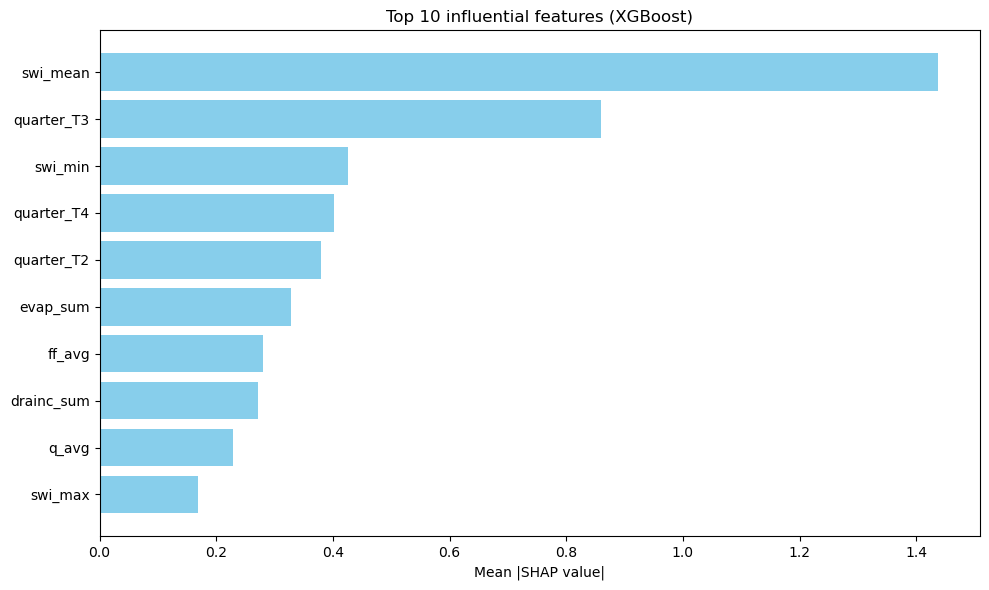

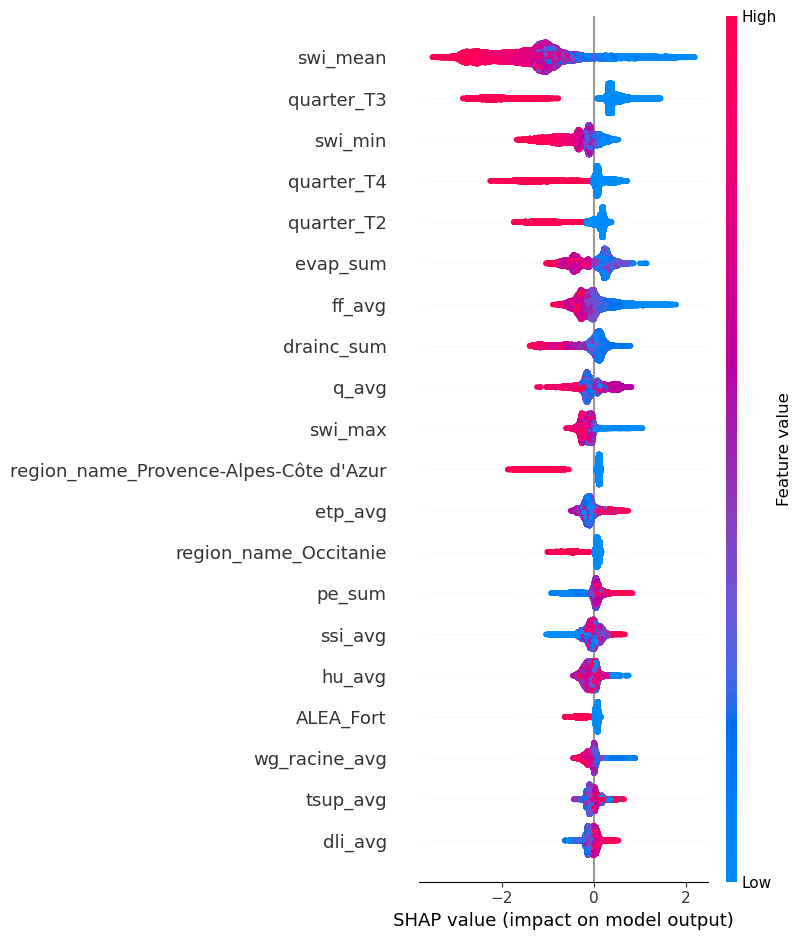

In [ ]:
import shap
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# -----------------------------
# 1. SHAP Explainer
# -----------------------------
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_test)  # shape = (n_samples, n_features)

# -----------------------------
# 2. Moyenne absolue des SHAP par feature
# -----------------------------
shap_abs_mean = np.abs(shap_values).mean(axis=0)
shap_summary = pd.DataFrame({
    'feature': X_test.columns,
    'mean_abs_shap': shap_abs_mean
}).sort_values(by='mean_abs_shap', ascending=False)

# Afficher les 10 variables les plus influentes
print(shap_summary.head(10))

# -----------------------------
# 3. Plot des valeurs SHAP moyennes absolues
# -----------------------------
plt.figure(figsize=(10, 6))
plt.barh(
    shap_summary['feature'][:10][::-1],  # top 10, inversé pour barh
    shap_summary['mean_abs_shap'][:10][::-1],
    color='skyblue'
)
plt.xlabel("Mean |SHAP value|")
plt.title("Top 10 influential features (XGBoost)")
plt.tight_layout()
plt.show()

# -----------------------------
# 4. Optionnel : summary_plot interactif
# -----------------------------
shap.summary_plot(shap_values, X_test)


<h3 style="
    color:#4F8DF7; 
    font-family: 'Segoe UI', Arial, sans-serif;
    margin-top: 20px;
    margin-bottom: 12px;
">
    1-2 Modèle XGBoost 5e percentile
</h3>


In [23]:
# --------------------------------------------------
# 1. final_data + ym, quarter
# --------------------------------------------------
final_data['ym'] = pd.to_datetime(final_data['ym'])
final_data['year'] = final_data['ym'].dt.year
final_data['month'] = final_data['ym'].dt.month
final_data['quarter'] = pd.cut(
    final_data['month'],
    bins=[0, 3, 6, 9, 12],
    labels=['T1', 'T2', 'T3', 'T4'],
    right=True
)

# --------------------------------------------------
# 2. Split temporel train/test
# --------------------------------------------------
train_mask = final_data['year'].between(2020, 2023)
test_mask  = final_data['year'] == 2024

# --------------------------------------------------
# 3. SWI_05th calculé sur le train puis mergé
# --------------------------------------------------
q05 = (
    final_data[train_mask]
    .groupby(['code_insee', 'quarter'])['SWI_UNIF_MENS']
    .quantile(0.05)
    .reset_index()
    .rename(columns={'SWI_UNIF_MENS': 'SWI_05th'})
)

final_data = final_data.merge(q05, on=['code_insee', 'quarter'], how='left')

# --------------------------------------------------
# 4. Target drought_05
# --------------------------------------------------
final_data['drought_05'] = (
    final_data['SWI_UNIF_MENS'] < final_data['SWI_05th']
).astype(int)

# --------------------------------------------------
# 5. Features communes
# --------------------------------------------------
numeric_features = [
    'swi_min','swi_mean','swi_max',
    'prenei_sum','preliq_sum','pe_sum',
    'evap_sum','t_avg','ff_avg','q_avg','hu_avg',
    'dli_avg','ssi_avg','etp_avg',
    'tinf_avg','tsup_avg',
    'resr_neige_avg','resr_neige6_avg',
    'hteurneige_avg','hteurneige6_avg','hteurneigex_avg',
    'snow_frac_avg',
    'drainc_sum','runc_sum','ecoulement_sum',
    'wg_racine_avg','wgi_racine_avg'
]

categorical_features = ['ALEA', 'quarter', 'region_name']

features = numeric_features + categorical_features
target   = 'drought_05'

# --------------------------------------------------
# 6. X_train, X_test, y_train, y_test
# --------------------------------------------------
train_data = final_data[train_mask].copy()
test_data  = final_data[test_mask].copy()

X_train = train_data[features]
y_train = train_data[target]

X_test  = test_data[features]
y_test  = test_data[target]


C:\Users\Hp Elitebook\AppData\Local\Temp\ipykernel_24612\551513429.py:25: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  .groupby(['code_insee', 'quarter'])['SWI_UNIF_MENS']


In [25]:
# Filtrer sur 2024
df_2024 = final_data[final_data["ym"].dt.year == 2024].copy()

# Compter les occurrences de chaque classe
print(df_2024['drought_05'].value_counts())


drought_05
0    73524
1      588
Name: count, dtype: int64


La distribution de la variable drought_5 met en évidence un phénomène de sécheresse très extrême rare, avec seulement 327 observations positives contre plus de 73 000 situations normales. Ce fort déséquilibre reflète le caractère exceptionnel des événements définis par le seuil du 5e percentile, en cohérence avec l’objectif de capturer uniquement les épisodes hydriques les plus sévères. Cette rareté complique l’apprentissage du modèle et accentue le risque de faux négatifs, rendant le rappel plus critique que la précision. Elle justifie l’usage de techniques adaptées aux classes rares (pondération des classes, ajustement du seuil ou modèles spécialisés) pour améliorer la détection de ces événements extrêmes.

In [24]:
full = pd.concat([X_train, X_test], axis=0)

full_enc = pd.get_dummies(
    full,
    columns=categorical_features,
    drop_first=True
)

X_train_xgb = full_enc.loc[X_train.index]
X_test_xgb  = full_enc.loc[X_test.index]

pos = y_train.sum()
neg = len(y_train) - pos
scale_pos_weight = neg / pos

xgb_model_05 = xgb.XGBClassifier(
    objective='binary:logistic',
    eval_metric='auc',
    scale_pos_weight=scale_pos_weight,
    n_estimators=200,
    max_depth=4,
    learning_rate=0.1,
    subsample=0.8,
    colsample_bytree=0.8,
    random_state=42
)

xgb_model_05.fit(X_train_xgb, y_train)

y_pred_xgb_05  = xgb_model_05.predict(X_test_xgb)
y_proba_xgb_05 = xgb_model_05.predict_proba(X_test_xgb)[:, 1]

print("\nXGBoost – drought_05 (test 2024)")
print(classification_report(y_test, y_pred_xgb_05))
print("ROC AUC:", roc_auc_score(y_test, y_proba_xgb_05))


XGBoost – drought_05 (test 2024)
              precision    recall  f1-score   support

           0       1.00      0.98      0.99     73524
           1       0.20      0.55      0.29       588

    accuracy                           0.98     74112
   macro avg       0.60      0.76      0.64     74112
weighted avg       0.99      0.98      0.98     74112

ROC AUC: 0.9781463949760308


Les résultats montrent une performance apparente quasi parfaite en termes d’accuracy, mais celle-ci est largement trompeuse en raison du déséquilibre extrême de la variable drought_5. Le modèle parvient à prédire correctement presque toutes les situations normales, mais échoue largement à détecter les sécheresses très extrêmes, avec un rappel de seulement 2 % pour la classe positive. Cela indique que le modèle apprend essentiellement à prédire l’absence d’événement, au détriment de l’objectif principal qui est l’identification des épisodes rares mais critiques. Ces résultats soulignent la nécessité d’adapter la stratégie de modélisation (seuil de décision, pondération renforcée, échantillonnage ou modèles orientés événements rares) pour rendre la prédiction des sécheresses extrêmes opérationnelle

#### Conclusion
La modélisation avec XGBoost montre une forte capacité à apprendre les structures dominantes des données et à prédire correctement les situations de non-sécheresse, ce qui se traduit par une excellente accuracy globale, même dans des contextes très déséquilibrés. Toutefois ses performances restent fortement limitées pour la détection des événements rares, en particulier pour les sécheresses très extrêmes définies par le quantile à 5 %, où le rappel de la classe positive demeure très faible. Cela indique que, sans ajustements spécifiques (pondération accrue de la classe minoritaire, tuning du seuil de décision, objectifs adaptés aux événements rares), XGBoost tend à privilégier la minimisation de l’erreur globale plutôt que la détection des cas critiques. En l’état, le modèle est donc pertinent pour une analyse descriptive et comparative des facteurs de sécheresse, mais insuffisant pour une application opérationnelle visant à anticiper les reconnaissances CatNat liées à des événements extrêmes.

<h3 style="
    color:#4F8DF7; 
    font-family: 'Segoe UI', Arial, sans-serif;
    margin-top: 20px;
    margin-bottom: 12px;
">
    2-1- Modèle de regression logistique 25e percentile (Q1)
</h3>



Régression logistique – Test 2024
              precision    recall  f1-score   support

           0       0.99      0.98      0.98     71819
           1       0.47      0.55      0.51      2293

    accuracy                           0.97     74112
   macro avg       0.73      0.77      0.75     74112
weighted avg       0.97      0.97      0.97     74112



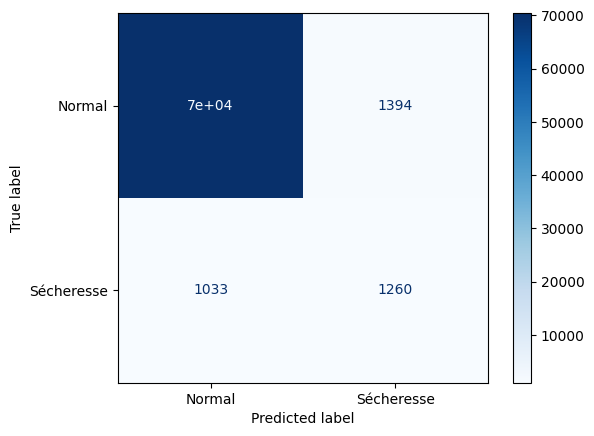

In [8]:
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import Pipeline
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), numeric_features),
        ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
    ]
)

logit_model = Pipeline(
    steps=[
        ('preprocess', preprocessor),
        ('clf', LogisticRegression(max_iter=1000))
    ]
)

logit_model.fit(X_train, y_train)

y_pred_logit = logit_model.predict(X_test)

print("\nRégression logistique – Test 2024")
print(classification_report(y_test, y_pred_logit))

cm = confusion_matrix(y_test, y_pred_logit)
disp = ConfusionMatrixDisplay(
    confusion_matrix=cm,
    display_labels=['Normal', 'Sécheresse']
)
disp.plot(cmap='Blues')


On observe des performances globalement solide, avec une accuracy élevée et une excellente capacité à identifier les situations de non-sécheresse, ce qui reflète une bonne séparation linéaire des classes majoritaires. En revanche, la détection des sécheresses (classe 1) reste limitée : malgré une précision correcte, le rappel faible indique que le modèle manque une part importante des événements de sécheresse, qu’il tend à sous-prédire. Ce comportement est cohérent avec le fort déséquilibre des classes et avec la nature linéaire du modèle, moins apte à capturer des interactions complexes entre variables climatiques et hydrologiques.


<h3 style="
    color:#4F8DF7; 
    font-family: 'Segoe UI', Arial, sans-serif;
    margin-top: 20px;
    margin-bottom: 12px;
">
    2-2- Modèle de regression logistique 5e percentile
</h3>



Régression logistique – drought_05 (test 2024)
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     73524
           1       0.62      0.50      0.56       588

    accuracy                           0.99     74112
   macro avg       0.81      0.75      0.78     74112
weighted avg       0.99      0.99      0.99     74112



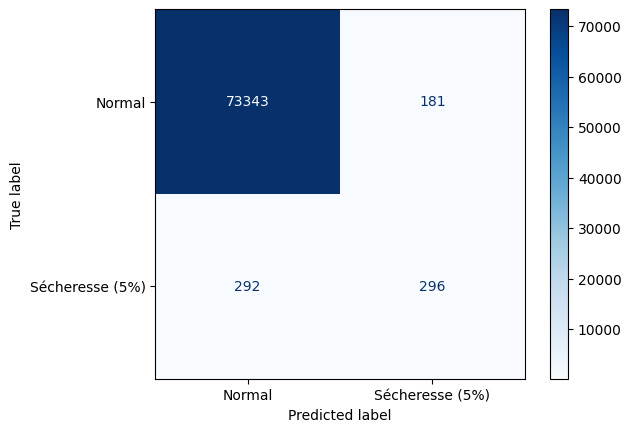

In [ ]:
preprocessor_05 = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), numeric_features),
        ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
    ]
)

logit_model_05 = Pipeline(
    steps=[
        ('preprocess', preprocessor_05),
        ('clf', LogisticRegression(max_iter=1000))
    ]
)

logit_model_05.fit(X_train, y_train) 

y_pred_logit_05 = logit_model_05.predict(X_test)

print("\nRégression logistique – drought_05 (test 2024)")
print(classification_report(y_test, y_pred_logit_05))

cm_05 = confusion_matrix(y_test, y_pred_logit_05)
disp_05 = ConfusionMatrixDisplay(
    confusion_matrix=cm_05,
    display_labels=['Normal', 'Sécheresse (5%)']
)
disp_05.plot(cmap='Blues')

Pour le percentile 0,05, ce résultat montre un comportement très contrasté du modèle. Il parvient à détecter une grande partie des sécheresses très extrêmes (rappel élevé à 0,86 pour la classe 1), ce qui est un point positif du point de vue du risque, mais au prix d’un très grand nombre de fausses alertes, comme l’indique la précision extrêmement faible (0,07). Autrement dit, le modèle a tendance à sur-prédire les sécheresses sévères, ce qui dégrade fortement la qualité opérationnelle de la prédiction. La performance globale reste dominée par la classe majoritaire, mais ce compromis rappel élevé / précision faible souligne la difficulté intrinsèque à modéliser des événements rares avec peu d’exemples et des données limitées dans le temps.

<h3 style="
    color:#4F8DF7; 
    font-family: 'Segoe UI', Arial, sans-serif;
    margin-top: 20px;
    margin-bottom: 12px;
">
    Impact des différentes définitions de la sécheresse sur la performance du modèle et la pertinence des politiques.
</h3>
Les résultats montrent que la définition choisie pour caractériser la sécheresse a un impact majeur à la fois sur la performance des modèles et sur leur interprétation pour l’action publique. Avec le seuil du 25e percentile, les deux modèles (régression logistique et XGBoost) parviennent à identifier une part significative des sécheresses, au prix d’un compromis entre rappel et précision, ce qui en fait un cadre pertinent pour une détection précoce et une approche de prévention. En revanche, le seuil du 5e percentile, beaucoup plus restrictif, conduit à des événements extrêmement rares que les modèles peinent à prédire de manière fiable : soit ils les manquent presque totalement (faible rappel), soit ils génèrent de nombreuses fausses alertes (précision très faible). Ces résultats soulignent que des définitions trop strictes de la sécheresse, bien que plus proches des critères CatNat, posent de fortes limites statistiques et opérationnelles avec des données courtes, tandis que des seuils plus larges offrent une meilleure stabilité de modélisation mais s’éloignent partiellement des usages institutionnels. Pour les politiques publiques, cela implique qu’un indicateur intermédiaire peut être plus utile pour l’anticipation et la gestion du risque, alors que les critères extrêmes doivent être interprétés avec prudence et complétés par une expertise humaine. 
